## Dominika Kresa
### r0878053

# scRNA-seq analysis of Parkinson's Disease in the substantia nigra pars compacta

### GEO number of data used in this analysis: GSE178265 (https://www.ncbi.nlm.nih.gov/geo/query/acc.cgi?acc=GSE178265)

# Import packages

In [1]:
import scanpy as sc
import os
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import gseapy
import warnings
import scenicplus

%load_ext autoreload
%autoreload 2
%matplotlib inline
sc.settings.set_figure_params(dpi=80, frameon=False, figsize=(7,7), facecolor='white')

In [2]:
gseapy.__version__

'1.0.2'

# Load data

In [757]:
# Working directories
work_dir = '/scratch/leuven/343/vsc34319/RegulatoryGenomics/'
raw_data_dir = work_dir + 'data/'
CellRanger_out_dir = work_dir + 'CellRanger_out/'

In [758]:
os.getcwd() # get current directory

'/lustre1/scratch/343/vsc34319/RegulatoryGenomics'

# scRNA-seq preprocessing using Scanpy

In [8]:
# Read in the count matrix into an AnnData object, which holds many slots for annotations and different representations of the data. It also comes with its own HDF5-based file format:.h5ad
adata_all = sc.read_mtx(os.path.join(raw_data_dir, 'matrix.mtx.gz')).T

In [411]:
#adata_all.write(os.path.join(work_dir, 'parkinson.h5ad')) 

In [808]:
adata = adata_all.copy()

In [809]:
# Read in the gene names
gene_ids = pd.read_csv(os.path.join(raw_data_dir, 'features.tsv.gz'), sep='\t', header=None).iloc[:, 1].values
adata.var = pd.DataFrame(index=gene_ids)
adata.var_names_make_unique()
adata.var

""
RP11-34P13.3
FAM138A
OR4F5
RP11-34P13.7
RP11-34P13.8
...
RN7SL739P
MIR4502
RNU4-10P
RN7SL865P


In [810]:
# Read in metadata
metadata = pd.read_csv(os.path.join(raw_data_dir, 'metadata.tsv.gz'), sep='\t').iloc[1: , :]
metadata = metadata[metadata.species__ontology_label == 'Homo sapiens']
metadata.index = metadata.iloc[:,0]
adata.obs = metadata
adata.obs

/tmp/ipykernel_1398284/2786864823.py:2: DtypeWarning: Columns (3,13,14,15) have mixed types. Specify dtype option on import or set low_memory=False.
  metadata = pd.read_csv(os.path.join(raw_data_dir, 'metadata.tsv.gz'), sep='\t').iloc[1: , :]


,NAME,libname,biosample_id,donor_id,species,species__ontology_label,disease,disease__ontology_label,organ,organ__ontology_label,library_preparation_protocol,library_preparation_protocol__ontology_label,sex,date,Donor_Age,Donor_PMI,Status,Cause_of_Death,FACS_Classification
NAME,,,,,,,,,,,,,,,,,,,
pPDCN4340DAPIA030419_AATGCCACACAAGCAG-1,pPDCN4340DAPIA030419_AATGCCACACAAGCAG-1,pPDCN4340DAPIA030419,pPDCN4340DAPIA030419,4340,NCBITaxon_9606,Homo sapiens,PATO_0000461,normal,UBERON_0001873,caudate nucleus,EFO_0009901,10x 3' v1,male,190304,47,12.5,Ctrl,Esophageal cancer with liver mets,Negative
pPDCN4340DAPIA030419_AGACTCAGTCACAATC-1,pPDCN4340DAPIA030419_AGACTCAGTCACAATC-1,pPDCN4340DAPIA030419,pPDCN4340DAPIA030419,4340,NCBITaxon_9606,Homo sapiens,PATO_0000461,normal,UBERON_0001873,caudate nucleus,EFO_0009901,10x 3' v1,male,190304,47,12.5,Ctrl,Esophageal cancer with liver mets,Negative
pPDCN4340DAPIA030419_ATACTTCCAGCGTTGC-1,pPDCN4340DAPIA030419_ATACTTCCAGCGTTGC-1,pPDCN4340DAPIA030419,pPDCN4340DAPIA030419,4340,NCBITaxon_9606,Homo sapiens,PATO_0000461,normal,UBERON_0001873,caudate nucleus,EFO_0009901,10x 3' v1,male,190304,47,12.5,Ctrl,Esophageal cancer with liver mets,Negative
pPDCN4340DAPIA030419_ATATCCTGTGTGTTTG-1,pPDCN4340DAPIA030419_ATATCCTGTGTGTTTG-1,pPDCN4340DAPIA030419,pPDCN4340DAPIA030419,4340,NCBITaxon_9606,Homo sapiens,PATO_0000461,normal,UBERON_0001873,caudate nucleus,EFO_0009901,10x 3' v1,male,190304,47,12.5,Ctrl,Esophageal cancer with liver mets,Negative
pPDCN4340DAPIA030419_ATCCACCGTGGGTTGA-1,pPDCN4340DAPIA030419_ATCCACCGTGGGTTGA-1,pPDCN4340DAPIA030419,pPDCN4340DAPIA030419,4340,NCBITaxon_9606,Homo sapiens,PATO_0000461,normal,UBERON_0001873,caudate nucleus,EFO_0009901,10x 3' v1,male,190304,47,12.5,Ctrl,Esophageal cancer with liver mets,Negative
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
pPDsHSrSNxi3298d200429PosB_CATACTTGTCTGATCA-1,pPDsHSrSNxi3298d200429PosB_CATACTTGTCTGATCA-1,pPDsHSrSNxi3298d200429PosB,pPDsHSrSNxi3298d200429PosB,3298,NCBITaxon_9606,Homo sapiens,PATO_0000461,normal,UBERON_0001965,substantia nigra pars compacta,EFO_0009901,10x 3' v1,male,200429,79.0,22.0,Ctrl,Prostate cancer,Positive
pPDsHSrSNxi3298d200429PosB_TTTGTTGTCCTTGAAG-1,pPDsHSrSNxi3298d200429PosB_TTTGTTGTCCTTGAAG-1,pPDsHSrSNxi3298d200429PosB,pPDsHSrSNxi3298d200429PosB,3298,NCBITaxon_9606,Homo sapiens,PATO_0000461,normal,UBERON_0001965,substantia nigra pars compacta,EFO_0009901,10x 3' v1,male,200429,79.0,22.0,Ctrl,Prostate cancer,Positive
pPDsHSrSNxi3298d200429PosB_ACACTGACACTAGAGG-1,pPDsHSrSNxi3298d200429PosB_ACACTGACACTAGAGG-1,pPDsHSrSNxi3298d200429PosB,pPDsHSrSNxi3298d200429PosB,3298,NCBITaxon_9606,Homo sapiens,PATO_0000461,normal,UBERON_0001965,substantia nigra pars compacta,EFO_0009901,10x 3' v1,male,200429,79.0,22.0,Ctrl,Prostate cancer,Positive


In [811]:
adata

AnnData object with n_obs × n_vars = 434340 × 41625
    obs: 'NAME', 'libname', 'biosample_id', 'donor_id', 'species', 'species__ontology_label', 'disease', 'disease__ontology_label', 'organ', 'organ__ontology_label', 'library_preparation_protocol', 'library_preparation_protocol__ontology_label', 'sex', 'date', 'Donor_Age', 'Donor_PMI', 'Status', 'Cause_of_Death', 'FACS_Classification'

In [812]:
# select metadata for substantia nigra pars compacta
adata = adata[adata.obs['organ__ontology_label'] == 'substantia nigra pars compacta'] 

In [813]:
# drop metadata for lewy body dementia
adata = adata[adata.obs['disease__ontology_label'] != 'Lewy body dementia']

In [814]:
adata.obs.groupby('organ__ontology_label')['disease__ontology_label'].value_counts()

organ__ontology_label           disease__ontology_label
substantia nigra pars compacta  normal                     184748
                                Parkinson disease          135344
Name: disease__ontology_label, dtype: int64

### Subset cells

In [815]:
import random
random.seed(10)
print(random.random())

0.5714025946899135


In [816]:
sc.pp.subsample(adata, fraction=None, n_obs=50000, random_state=10, copy=False)

In [817]:
adata.obs.groupby('organ__ontology_label')['disease__ontology_label'].value_counts()

organ__ontology_label           disease__ontology_label
substantia nigra pars compacta  normal                     29001
                                Parkinson disease          20999
Name: disease__ontology_label, dtype: int64

In [818]:
adata

AnnData object with n_obs × n_vars = 50000 × 41625
    obs: 'NAME', 'libname', 'biosample_id', 'donor_id', 'species', 'species__ontology_label', 'disease', 'disease__ontology_label', 'organ', 'organ__ontology_label', 'library_preparation_protocol', 'library_preparation_protocol__ontology_label', 'sex', 'date', 'Donor_Age', 'Donor_PMI', 'Status', 'Cause_of_Death', 'FACS_Classification'

In [819]:
# remove redundant columns
alist = ['NAME','libname', 'species', 'species__ontology_label', 'disease', 'organ', 'library_preparation_protocol', 'library_preparation_protocol__ontology_label', 'date', 'Donor_PMI']
for i in alist:
    del adata.obs[i]

In [820]:
adata

AnnData object with n_obs × n_vars = 50000 × 41625
    obs: 'biosample_id', 'donor_id', 'disease__ontology_label', 'organ__ontology_label', 'sex', 'Donor_Age', 'Status', 'Cause_of_Death', 'FACS_Classification'

In [821]:
adata.layers['counts'] = adata.X # Save raw counts

# Basic quality control

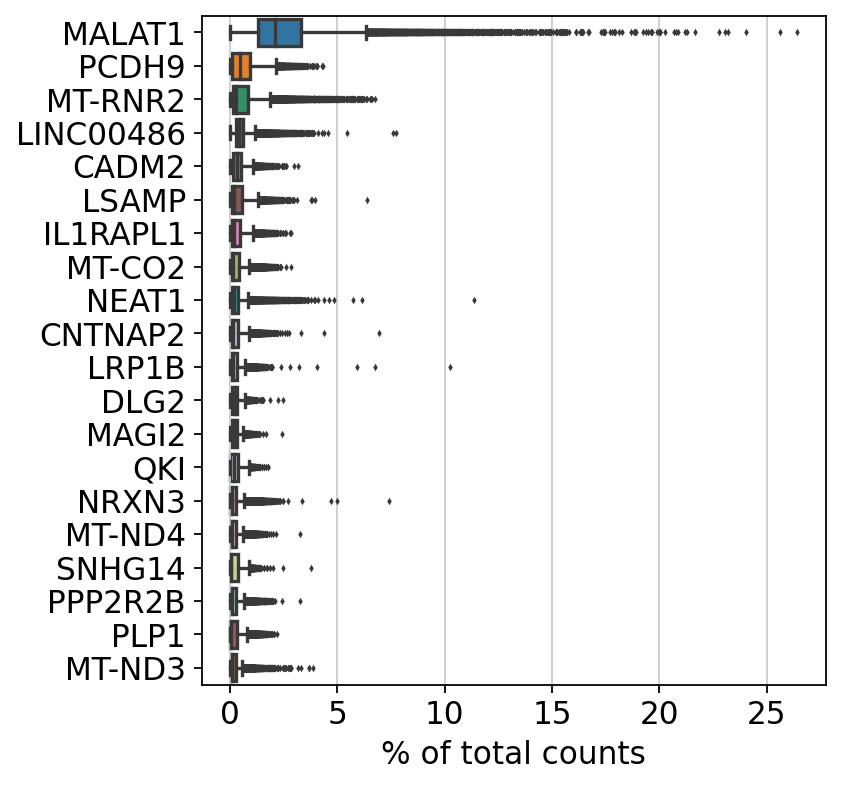

In [822]:
# Show those genes that yield the highest fraction of counts in each single cell, across all cells
sc.pl.highest_expr_genes(adata, n_top=20, )

In [823]:
# Keep cells with at least 200 genes expressed and genes which are expressed in at least 20 cells
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=20)
adata

AnnData object with n_obs × n_vars = 50000 × 29608
    obs: 'biosample_id', 'donor_id', 'disease__ontology_label', 'organ__ontology_label', 'sex', 'Donor_Age', 'Status', 'Cause_of_Death', 'FACS_Classification', 'n_genes'
    var: 'n_cells'
    layers: 'counts'

In [824]:
# Predict and filter out doublets using Scrublet
sc.external.pp.scrublet(adata) #estimates doublets

/vsc-hard-mounts/leuven-data/343/vsc34319/miniconda3/envs/ibp-2022-env/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.48
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 67.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.2%


In [825]:
adata = adata[adata.obs['predicted_doublet'] == False] # do the actual filtering
adata

View of AnnData object with n_obs × n_vars = 49926 × 29608
    obs: 'biosample_id', 'donor_id', 'disease__ontology_label', 'organ__ontology_label', 'sex', 'Donor_Age', 'Status', 'Cause_of_Death', 'FACS_Classification', 'n_genes', 'doublet_score', 'predicted_doublet'
    var: 'n_cells'
    uns: 'scrublet'
    layers: 'counts'

In [826]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

/tmp/ipykernel_1398284/2615436022.py:1: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'


### Remove cells that have too many mitochondrial genes expressed or too many total counts:

In [827]:
# check if mitochondrial genes are present
sum(adata.var_names.str.startswith('MT-'))

30

In [828]:
sc.pp.calculate_qc_metrics(adata, qc_vars=[], percent_top=None, log1p=False, inplace=True)
adata

AnnData object with n_obs × n_vars = 49926 × 29608
    obs: 'biosample_id', 'donor_id', 'disease__ontology_label', 'organ__ontology_label', 'sex', 'Donor_Age', 'Status', 'Cause_of_Death', 'FACS_Classification', 'n_genes', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'scrublet'
    layers: 'counts'

A violin plot of some of the computed quality measures:

- the number of genes expressed in the count matrix
- the total counts per cell
- the percentage of counts in mitochondrial genes

... storing 'biosample_id' as categorical
... storing 'disease__ontology_label' as categorical
... storing 'organ__ontology_label' as categorical
... storing 'sex' as categorical
... storing 'Status' as categorical
... storing 'Cause_of_Death' as categorical
... storing 'FACS_Classification' as categorical


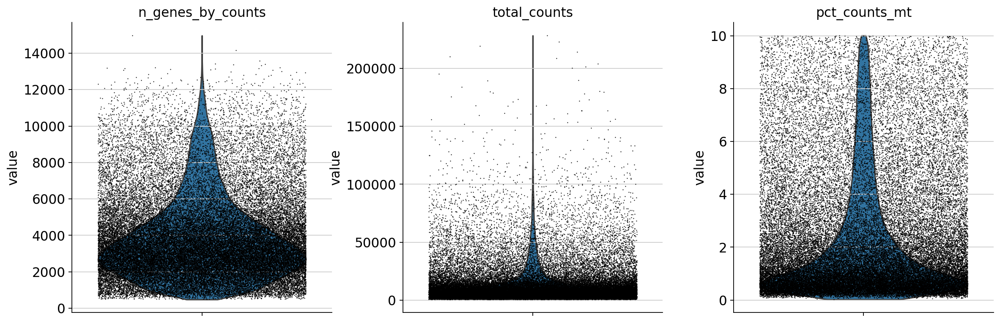

In [829]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

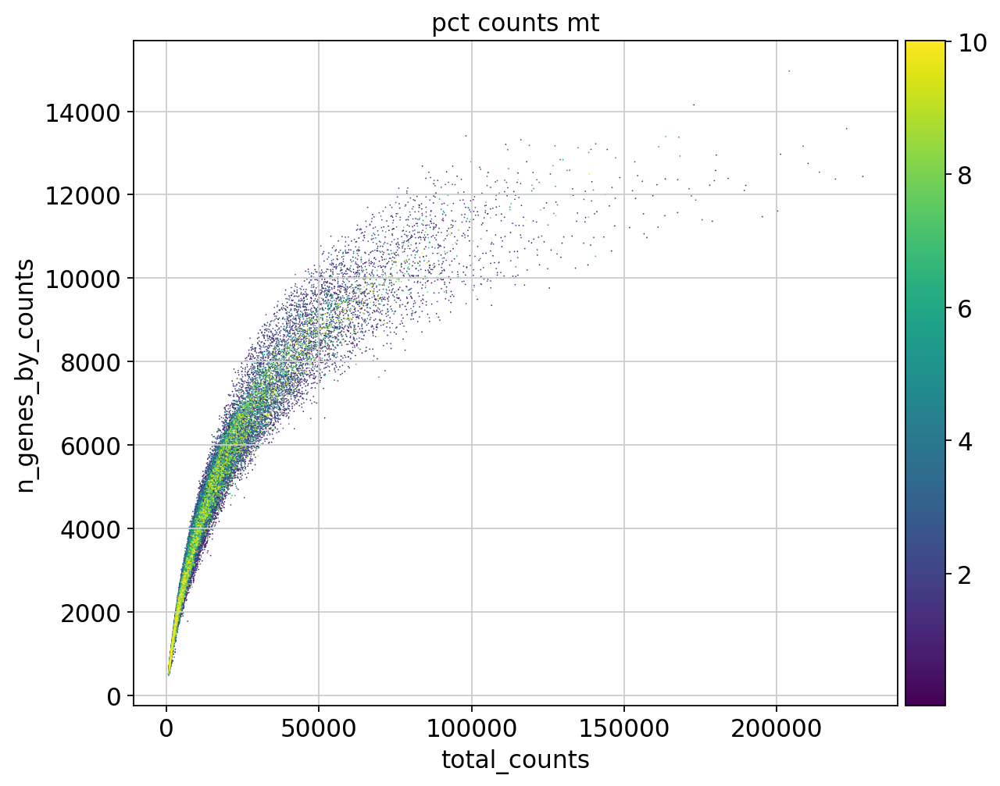

In [830]:
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts', color='pct_counts_mt')

In [831]:
upper_lim = np.quantile(adata.obs.n_genes_by_counts.values, .98)
lower_lim = np.quantile(adata.obs.n_genes_by_counts.values, .02)
print(f'{lower_lim} to {upper_lim}')

816.0 to 10022.5


In [832]:
adata = adata[(adata.obs.n_genes_by_counts < upper_lim) & (adata.obs.n_genes_by_counts > lower_lim)]

In [833]:
upper_lim = np.quantile(adata.obs.pct_counts_mt.values, .98)
lower_lim = np.quantile(adata.obs.pct_counts_mt.values, .02)
print(f'{lower_lim} to {upper_lim}')

0.2019257986545563 to 8.980769081115723


In [834]:
adata = adata[(adata.obs.pct_counts_mt < upper_lim) & (adata.obs.pct_counts_mt > lower_lim)]

In [835]:
adata

View of AnnData object with n_obs × n_vars = 46009 × 29608
    obs: 'biosample_id', 'donor_id', 'disease__ontology_label', 'organ__ontology_label', 'sex', 'Donor_Age', 'Status', 'Cause_of_Death', 'FACS_Classification', 'n_genes', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'scrublet'
    layers: 'counts'

# Data Normalization

In [836]:
# Total-count (library-size) correction normalize the data matrix X to 10,000 reads per cell, so that counts become comparable among cells
sc.pp.normalize_total(adata, target_sum=1e4)

# Logarithmize the data
sc.pp.log1p(adata)

adata.layers['lognorm'] = adata.X

adata.raw = adata

# Identify highly-variable genes
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

/vsc-hard-mounts/leuven-data/343/vsc34319/miniconda3/envs/ibp-2022-env/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


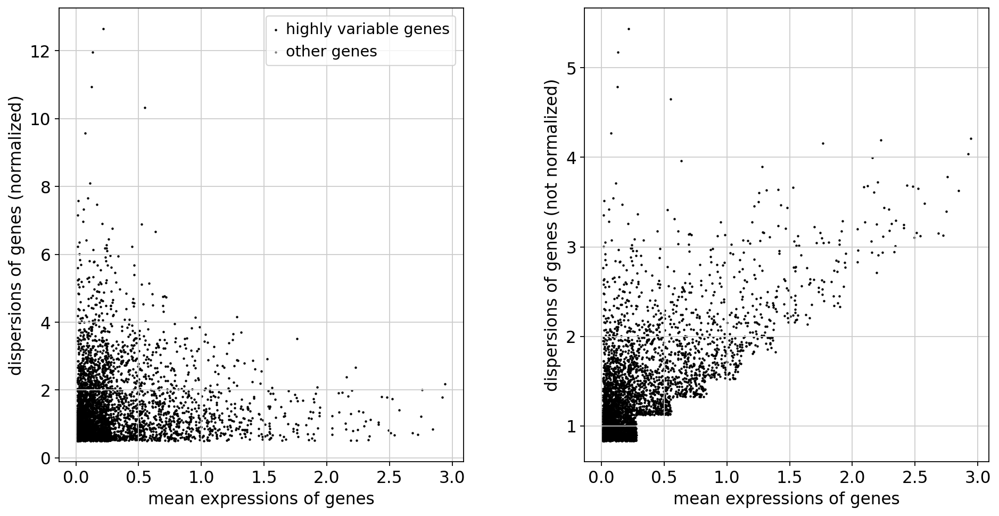

In [1289]:
var_genes_all = sc.pl.highly_variable_genes(adata)
var_genes_all 

In [838]:
# Do the filtering
adata = adata[:, adata.var.highly_variable]

# Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

# Scale each gene to unit variance. Clip values exceeding standard deviation 10
sc.pp.scale(adata, max_value=10)

adata

AnnData object with n_obs × n_vars = 46009 × 4431
    obs: 'biosample_id', 'donor_id', 'disease__ontology_label', 'organ__ontology_label', 'sex', 'Donor_Age', 'Status', 'Cause_of_Death', 'FACS_Classification', 'n_genes', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'scrublet', 'log1p', 'hvg'
    layers: 'counts', 'lognorm'

/vsc-hard-mounts/leuven-data/343/vsc34319/miniconda3/envs/ibp-2022-env/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:182: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


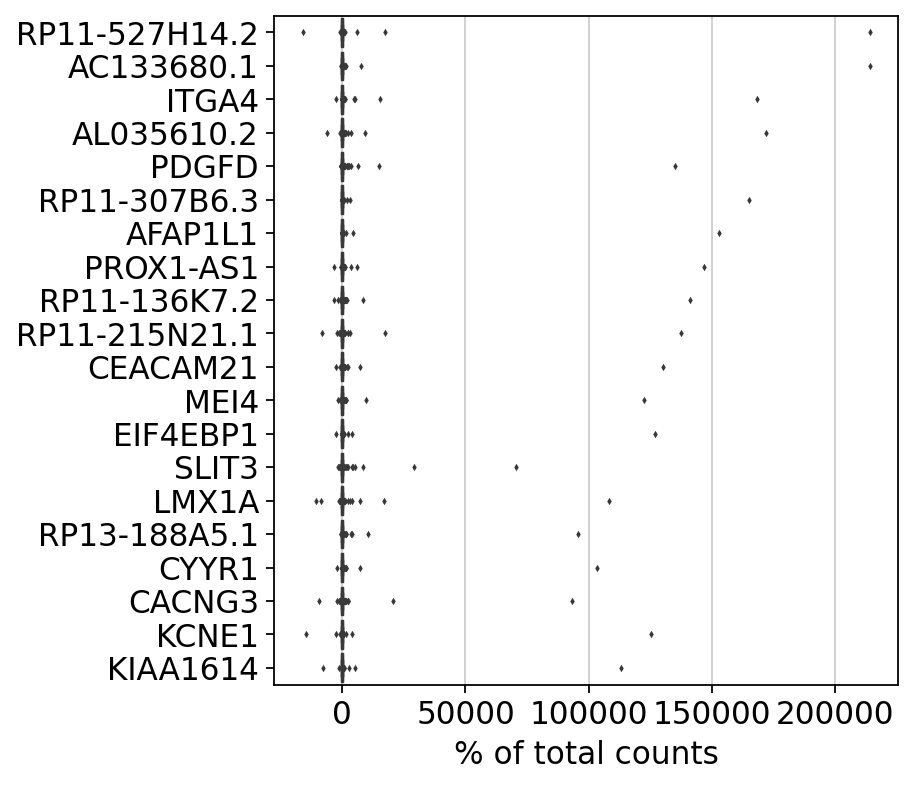

In [839]:
sc.pl.highest_expr_genes(adata, n_top=20)

# Save data

In [840]:
adata.obs['donor_id'] = adata.obs['donor_id'].astype(str)
adata.obs['Donor_Age'] = adata.obs['Donor_Age'].astype(str)

In [841]:
adata.obs

,biosample_id,donor_id,disease__ontology_label,organ__ontology_label,sex,Donor_Age,Status,Cause_of_Death,FACS_Classification,n_genes,doublet_score,predicted_doublet,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt
NAME,,,,,,,,,,,,,,,,
pPDsHSrSNxi3887d200429PosB_TAGCACAGTTACACTG-1,pPDsHSrSNxi3887d200429PosB,3887,Parkinson disease,substantia nigra pars compacta,male,82,PD,Parkinson's disease,Positive,1192,0.012371,False,1192,1766.0,63.0,3.567384
pPDsHSrSNxi3322d200429PosG_TGGTTAGGTGACTCTA-1,pPDsHSrSNxi3322d200429PosG,3322,normal,substantia nigra pars compacta,female,90,Ctrl,Colon cancer,Positive,3124,0.033062,False,3124,6421.0,317.0,4.936926
pPDsHSrSNxi4560d200429PosC_CCTGCATTCGGTCGAC-1,pPDsHSrSNxi4560d200429PosC,4560,Parkinson disease,substantia nigra pars compacta,female,83,PD,Parkinson's disease,Positive,3208,0.008901,False,3208,6931.0,192.0,2.770163
pPDsHSrSNxi4956d200429DAPIA_CTGCTCAGTAGTATAG-1,pPDsHSrSNxi4956d200429DAPIA,4956,normal,substantia nigra pars compacta,female,92,Ctrl,Prostate cancer,Negative,3171,0.003224,False,3171,7160.0,24.0,0.335196
pPDsHSrSNxi1963d200429DAPIA_TACGCTCCAGTCTCTC-1,pPDsHSrSNxi1963d200429DAPIA,1963,Parkinson disease,substantia nigra pars compacta,male,82,PD,Parkinson's disease,Negative,2082,0.002188,False,2082,3709.0,50.0,1.348072
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
pPDsHSrSNxi3322d200429PosF_GGGCTACGTCGATGCC-1,pPDsHSrSNxi3322d200429PosF,3322,normal,substantia nigra pars compacta,female,90,Ctrl,Colon cancer,Positive,2214,0.024484,False,2214,4710.0,98.0,2.080679
pPDsHSrSNxi3345d200429DAPIC_TGTCAGACAACACTAC-1,pPDsHSrSNxi3345d200429DAPIC,3345,normal,substantia nigra pars compacta,female,82,Ctrl,Colon cancer,Negative,2530,0.049790,False,2529,4831.0,48.0,0.993583
pPDsHSrSNxi4560d200429DAPIB_AGAGAATGTGACGTCC-1,pPDsHSrSNxi4560d200429DAPIB,4560,Parkinson disease,substantia nigra pars compacta,female,83,PD,Parkinson's disease,Negative,2874,0.015209,False,2874,6608.0,19.0,0.287530


In [842]:
adata.raw.to_adata().write(os.path.join(work_dir, 'parkinson_subset.raw.h5ad'))
adata.write(os.path.join(work_dir, 'parkinson_subset.h5ad'), compression='gzip') 

... storing 'donor_id' as categorical
... storing 'Donor_Age' as categorical
... storing 'donor_id' as categorical
... storing 'Donor_Age' as categorical


# PCA

Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [843]:
sc.tl.pca(adata, svd_solver='arpack')

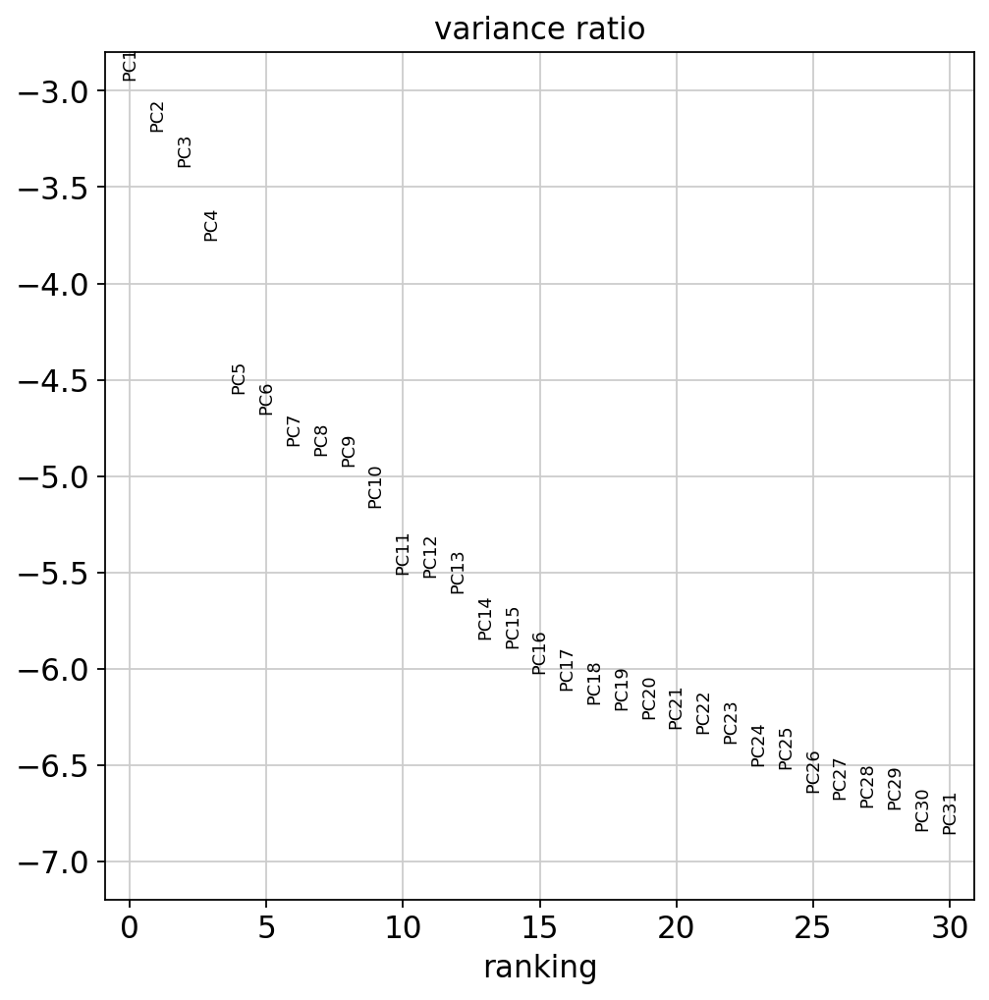

In [844]:
sc.pl.pca_variance_ratio(adata, log=True)

# Computing the neighborhood graph

Compute the neighborhood graph of cells using the PCA representation of the data matrix

In [845]:
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=11)

# Embedding the neighborhood graph

In [846]:
sc.tl.umap(adata)

# Clustering the neighborhood graph

There is no clear batch effect. The sample 2142 is partially separated but it is not considered as a separate cluster.

/vsc-hard-mounts/leuven-data/343/vsc34319/miniconda3/envs/ibp-2022-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/vsc-hard-mounts/leuven-data/343/vsc34319/miniconda3/envs/ibp-2022-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


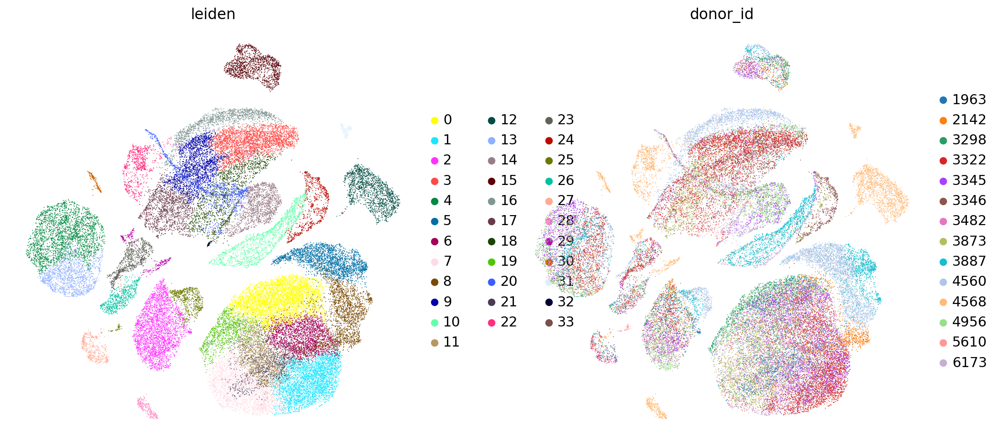

In [847]:
sc.tl.leiden(adata)
sc.pl.umap(adata, color=['leiden', 'donor_id'])

With leiden resolution 0.005, there are 6 clusters obtained

/vsc-hard-mounts/leuven-data/343/vsc34319/miniconda3/envs/ibp-2022-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


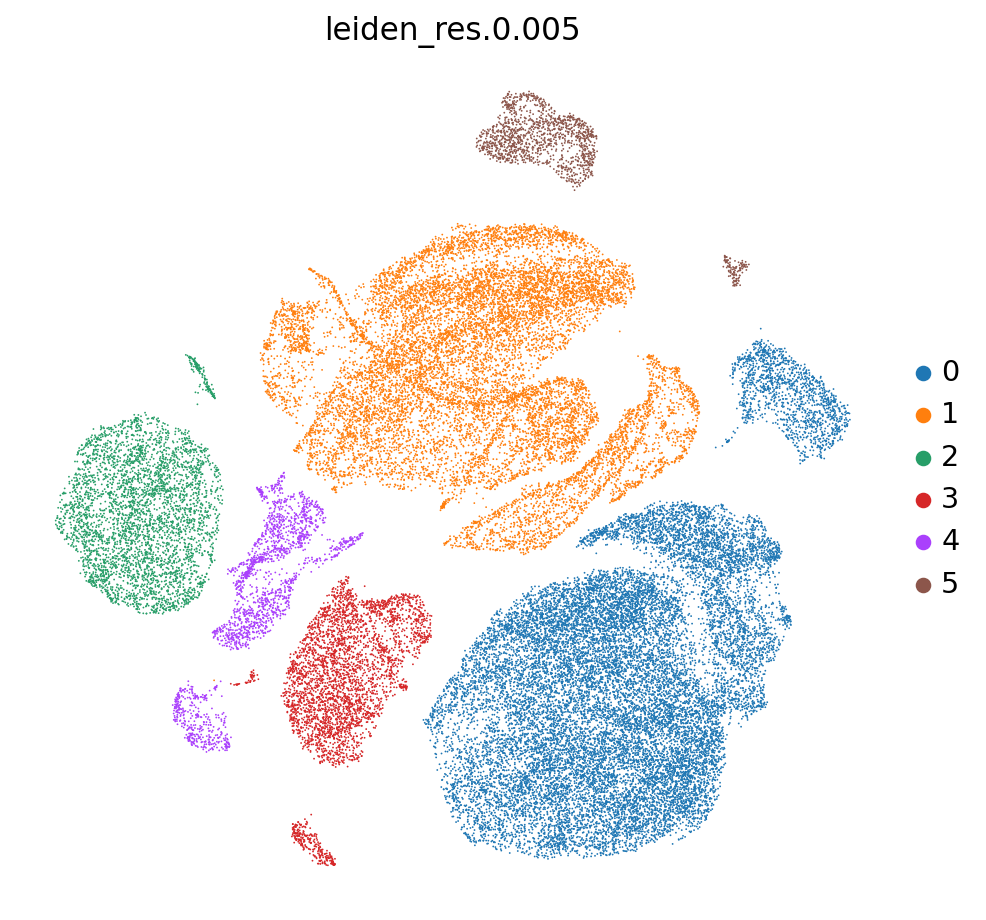

In [848]:
sc.tl.leiden(adata, resolution = 0.005, key_added = 'leiden_res.0.005')
sc.pl.umap(adata, color=['leiden_res.0.005'])

In [849]:
adata

AnnData object with n_obs × n_vars = 46009 × 4431
    obs: 'biosample_id', 'donor_id', 'disease__ontology_label', 'organ__ontology_label', 'sex', 'Donor_Age', 'Status', 'Cause_of_Death', 'FACS_Classification', 'n_genes', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'leiden_res.0.005'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'scrublet', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'donor_id_colors', 'leiden_res.0.005_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'lognorm'
    obsp: 'distances', 'connectivities'

# Annotate clusters

Marker genes were obtained from the paper "Single-cell transcriptomic atlas of the human substantia nigra in Parkinson’s disease" (https://doi.org/10.1101/2022.03.25.485846) and Panglao Database (https://panglaodb.se/index.html)

ASTR - Astrocytes; OLG - Oligodendrocytes; OPC - Oligodendrocyte Progenitor Cells; MG - Microglia; NEUR - Neurons; PER_END - Pericytes/Endothelial cells

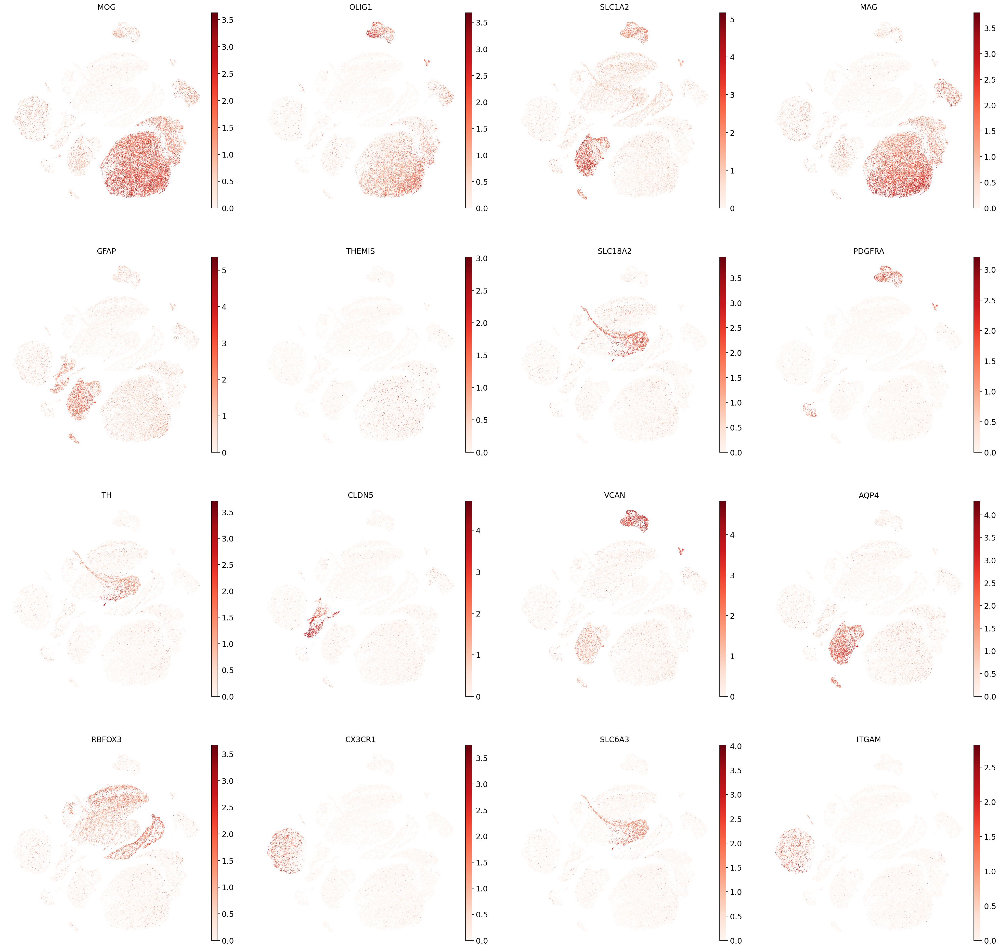

In [850]:
# Marker genes
ASTR = ['AQP4', 'VCAN', 'GFAP', 'SLC1A2'] #3 
OLG = ['OLIG1', 'MOG', 'MAG'] #0  
OPC = ['VCAN', 'OLIG1','PDGFRA', 'THEMIS'] #5 
MG = ['CX3CR1','ITGAM'] #2 
NEUR = ['TH', 'SLC6A3', 'RBFOX3','SLC18A2'] #1  
PER_END = ['CLDN5'] #4

marker_genes = list(set(ASTR + OLG + OPC + MG + NEUR + PER_END))

sc.pl.umap(adata, color=marker_genes, palette="Set2", color_map=mpl.cm.Reds)

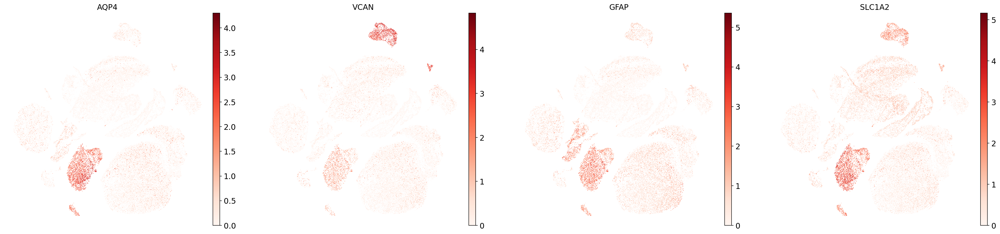

In [851]:
# ASTR 3
sc.pl.umap(adata, color=['AQP4', 'VCAN', 'GFAP', 'SLC1A2'], palette="Set2", color_map=mpl.cm.Reds)

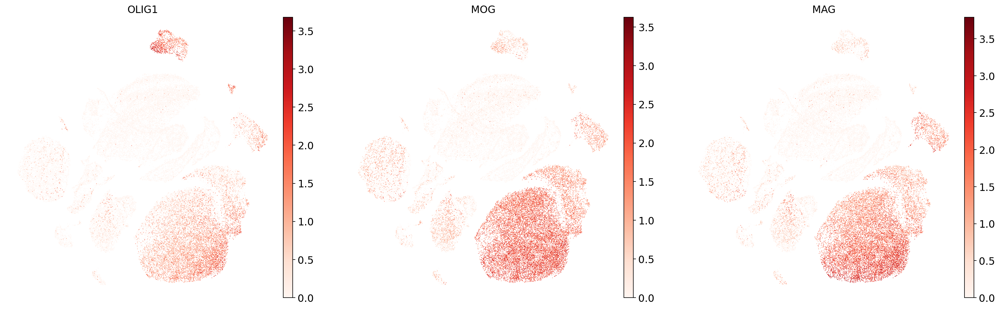

In [852]:
# OLG 0
sc.pl.umap(adata, color=['OLIG1', 'MOG', 'MAG'], palette="Set2", color_map=mpl.cm.Reds)

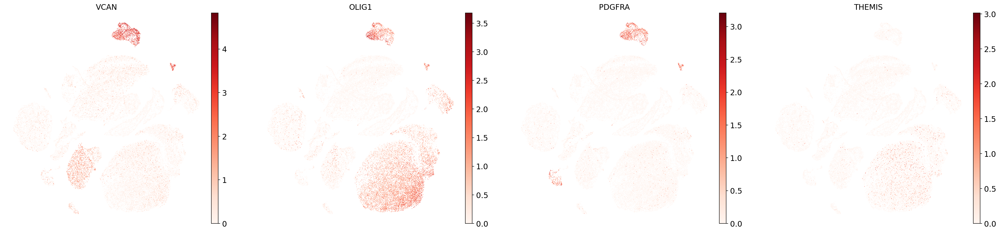

In [853]:
# OPC 5
sc.pl.umap(adata, color=['VCAN', 'OLIG1','PDGFRA', 'THEMIS'], palette="Set2", color_map=mpl.cm.Reds)

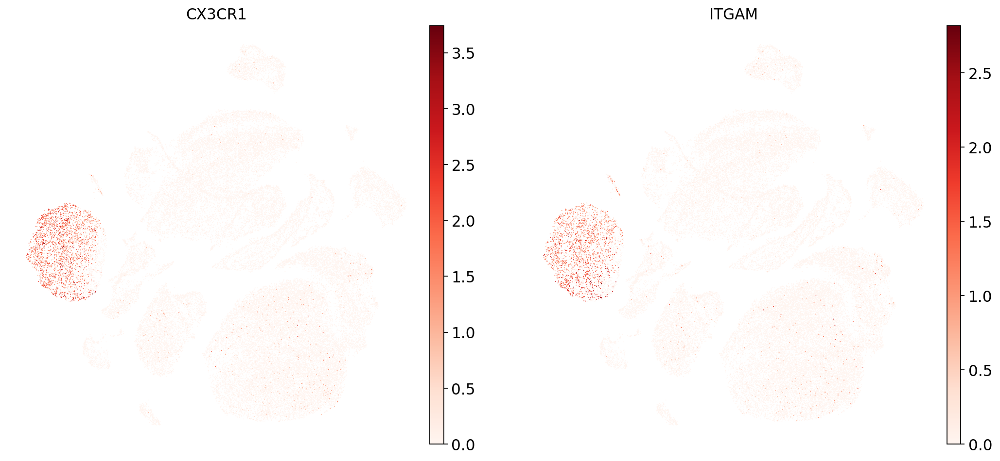

In [854]:
# MG 2
sc.pl.umap(adata, color=['CX3CR1','ITGAM'], palette="Set2", color_map=mpl.cm.Reds)

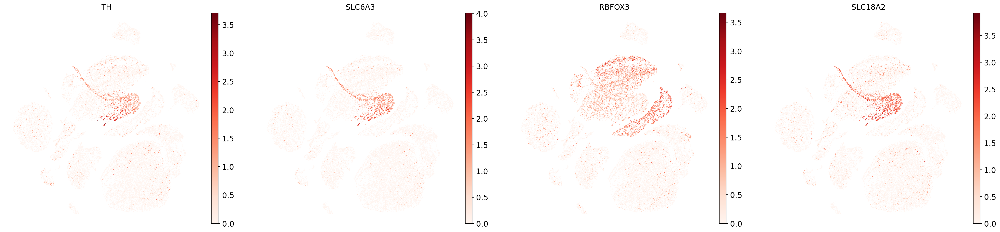

In [855]:
# NEUR 1
sc.pl.umap(adata, color=['TH', 'SLC6A3', 'RBFOX3','SLC18A2'], palette="Set2", color_map=mpl.cm.Reds)

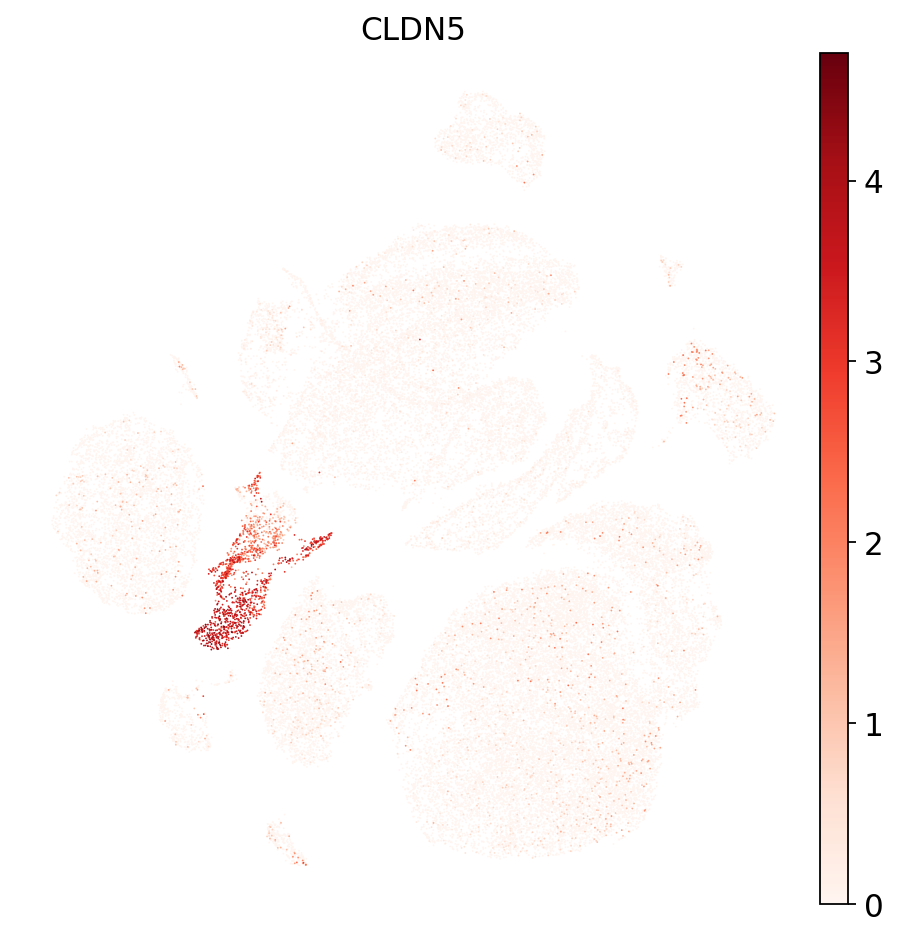

In [856]:
# PER_END 4
sc.pl.umap(adata, color=['CLDN5'], palette="Set2", color_map=mpl.cm.Reds)

In [857]:
annotations = ['OLG', 'NEUR', 'MG', 'ASTR', 'PER_END', 'OPC']
adata.rename_categories('leiden_res.0.005', annotations)

/vsc-hard-mounts/leuven-data/343/vsc34319/miniconda3/envs/ibp-2022-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1160: FutureWarning: The `inplace` parameter in pandas.Categorical.rename_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  self.obs[key].cat.rename_categories(categories, inplace=True)


/vsc-hard-mounts/leuven-data/343/vsc34319/miniconda3/envs/ibp-2022-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


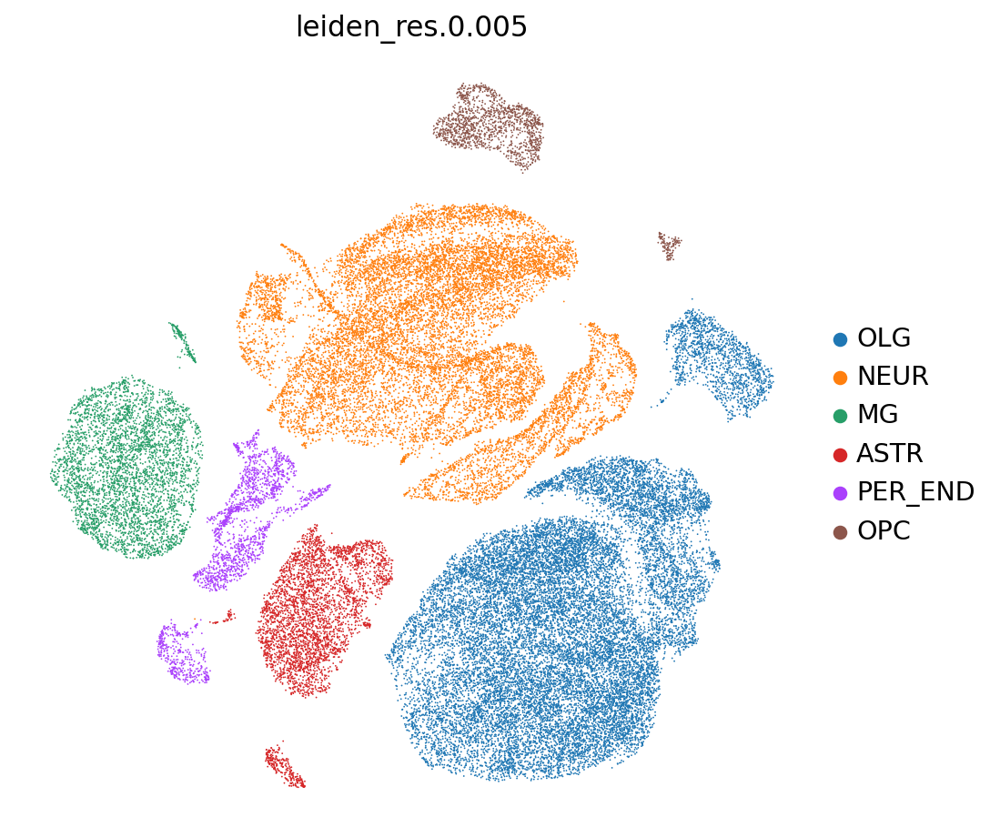

In [858]:
sc.pl.umap(adata, color=['leiden_res.0.005'])

In [859]:
adata.obs

,biosample_id,donor_id,disease__ontology_label,organ__ontology_label,sex,Donor_Age,Status,Cause_of_Death,FACS_Classification,n_genes,doublet_score,predicted_doublet,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden,leiden_res.0.005
NAME,,,,,,,,,,,,,,,,,,
pPDsHSrSNxi3887d200429PosB_TAGCACAGTTACACTG-1,pPDsHSrSNxi3887d200429PosB,3887,Parkinson disease,substantia nigra pars compacta,male,82,PD,Parkinson's disease,Positive,1192,0.012371,False,1192,1766.0,63.0,3.567384,27,PER_END
pPDsHSrSNxi3322d200429PosG_TGGTTAGGTGACTCTA-1,pPDsHSrSNxi3322d200429PosG,3322,normal,substantia nigra pars compacta,female,90,Ctrl,Colon cancer,Positive,3124,0.033062,False,3124,6421.0,317.0,4.936926,18,NEUR
pPDsHSrSNxi4560d200429PosC_CCTGCATTCGGTCGAC-1,pPDsHSrSNxi4560d200429PosC,4560,Parkinson disease,substantia nigra pars compacta,female,83,PD,Parkinson's disease,Positive,3208,0.008901,False,3208,6931.0,192.0,2.770163,16,NEUR
pPDsHSrSNxi4956d200429DAPIA_CTGCTCAGTAGTATAG-1,pPDsHSrSNxi4956d200429DAPIA,4956,normal,substantia nigra pars compacta,female,92,Ctrl,Prostate cancer,Negative,3171,0.003224,False,3171,7160.0,24.0,0.335196,2,ASTR
pPDsHSrSNxi1963d200429DAPIA_TACGCTCCAGTCTCTC-1,pPDsHSrSNxi1963d200429DAPIA,1963,Parkinson disease,substantia nigra pars compacta,male,82,PD,Parkinson's disease,Negative,2082,0.002188,False,2082,3709.0,50.0,1.348072,2,ASTR
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
pPDsHSrSNxi3322d200429PosF_GGGCTACGTCGATGCC-1,pPDsHSrSNxi3322d200429PosF,3322,normal,substantia nigra pars compacta,female,90,Ctrl,Colon cancer,Positive,2214,0.024484,False,2214,4710.0,98.0,2.080679,0,OLG
pPDsHSrSNxi3345d200429DAPIC_TGTCAGACAACACTAC-1,pPDsHSrSNxi3345d200429DAPIC,3345,normal,substantia nigra pars compacta,female,82,Ctrl,Colon cancer,Negative,2530,0.049790,False,2529,4831.0,48.0,0.993583,1,OLG
pPDsHSrSNxi4560d200429DAPIB_AGAGAATGTGACGTCC-1,pPDsHSrSNxi4560d200429DAPIB,4560,Parkinson disease,substantia nigra pars compacta,female,83,PD,Parkinson's disease,Negative,2874,0.015209,False,2874,6608.0,19.0,0.287530,8,OLG


# Finding marker genes

Compute a ranking for the highly differential genes in each cluster.

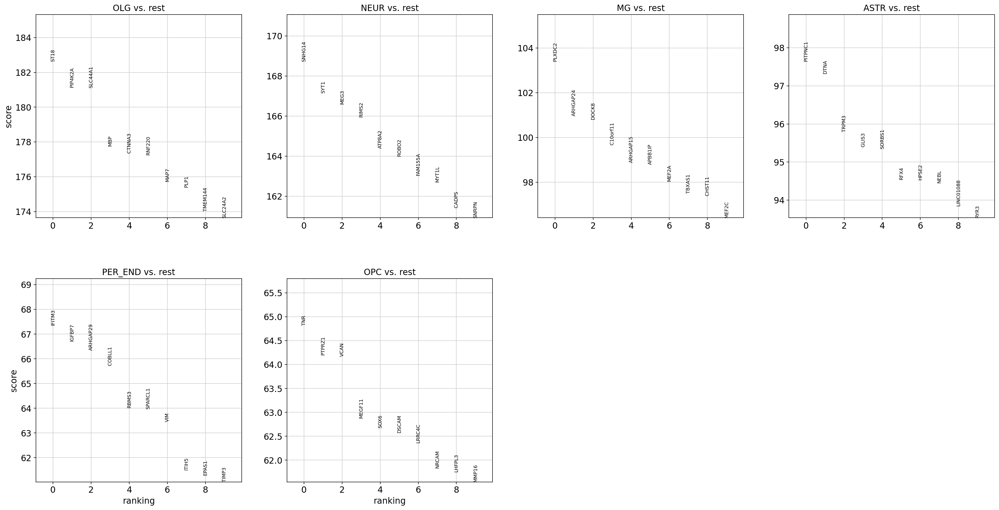

In [860]:
sc.tl.rank_genes_groups(adata, 'leiden_res.0.005', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=10, sharey=False)

/vsc-hard-mounts/leuven-data/343/vsc34319/miniconda3/envs/ibp-2022-env/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:2406: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  obs_tidy.index.value_counts(sort=False).iteritems()


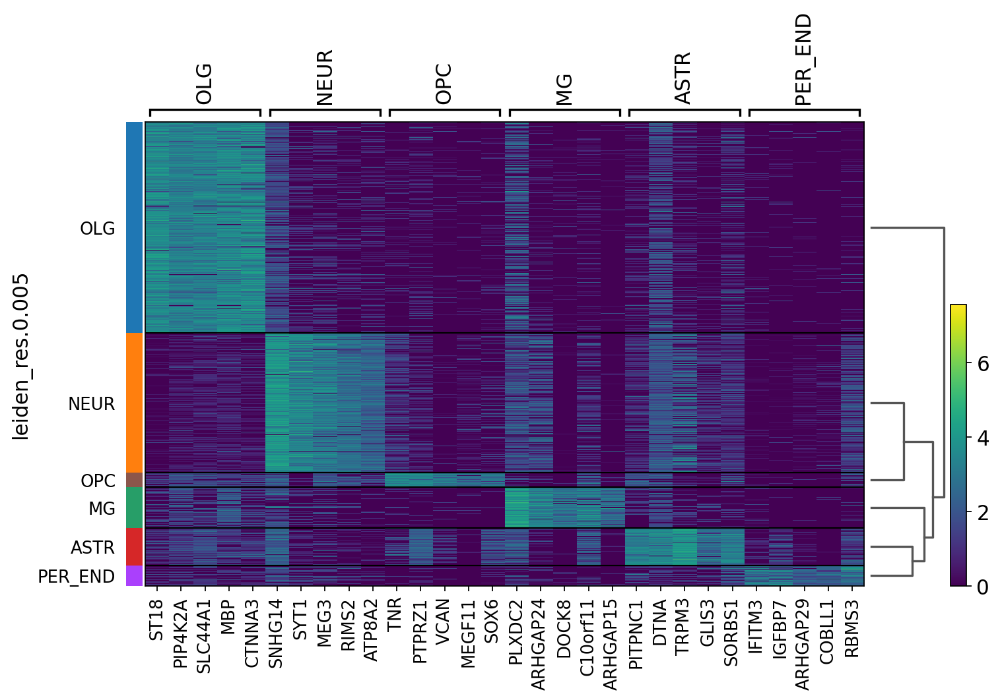

In [863]:
sc.pl.rank_genes_groups_heatmap(adata, n_genes=5, groupby="leiden_res.0.005", show_gene_labels=True)

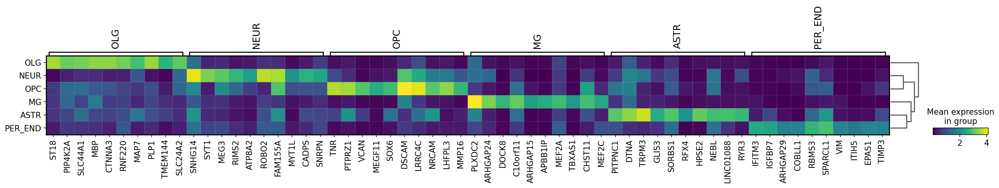

In [864]:
sc.pl.rank_genes_groups_matrixplot(adata, n_genes=10, groupby="leiden_res.0.005")

In [865]:
results = adata.uns['rank_genes_groups']

In [866]:
results

{'params': {'groupby': 'leiden_res.0.005',
  'reference': 'rest',
  'method': 'wilcoxon',
  'use_raw': True,
  'layer': None,
  'corr_method': 'benjamini-hochberg'},
 'names': rec.array([('ST18', 'SNHG14', 'PLXDC2', 'PITPNC1', 'IFITM3', 'TNR'),
            ('PIP4K2A', 'SYT1', 'ARHGAP24', 'DTNA', 'IGFBP7', 'PTPRZ1'),
            ('SLC44A1', 'MEG3', 'DOCK8', 'TRPM3', 'ARHGAP29', 'VCAN'), ...,
            ('FRMD4A', 'TCF12', 'NCAM1', 'MARCH1', 'PCDH9', 'NEAT1'),
            ('KCNMA1', 'ZBTB20', 'CADM2', 'ANK3', 'CADM2', 'LIMCH1'),
            ('CELF2', 'QKI', 'MAGI2', 'DNM3', 'NCAM1', 'NKAIN2')],
           dtype=[('OLG', 'O'), ('NEUR', 'O'), ('MG', 'O'), ('ASTR', 'O'), ('PER_END', 'O'), ('OPC', 'O')]),
 'scores': rec.array([( 182.62476,  168.7204 , 103.39415,  97.63892,  67.34593,  64.81642 ),
            ( 181.12215,  167.1431 , 100.96108,  97.31817,  66.70229,  64.197716),
            ( 181.11967,  166.5844 , 100.79967,  95.78916,  66.33838,  64.1697  ),
            ...,
            (-

In [867]:
results['names'].dtype.names

('OLG', 'NEUR', 'MG', 'ASTR', 'PER_END', 'OPC')

In [868]:
out = np.array([[0,0,0,0,0]])
for group in results['names'].dtype.names:
    out = np.vstack((out, np.vstack((results['names'][group],
                                     results['scores'][group],
                                     results['pvals_adj'][group],
                                     results['logfoldchanges'][group],
                                     np.array([group] * len(results['names'][group])).astype('object'))).T))

In [869]:
out.shape

(177649, 5)

In [870]:
markers = pd.DataFrame(out[1:], columns = ['Gene', 'scores', 'pval_adj', 'lfc', 'cluster'])


In [871]:
markers

,Gene,scores,pval_adj,lfc,cluster
0,ST18,182.624756,0.0,6.391556,OLG
1,PIP4K2A,181.122147,0.0,4.425962,OLG
2,SLC44A1,181.119675,0.0,4.381897,OLG
3,MBP,177.746704,0.0,4.492414,OLG
4,CTNNA3,177.350204,0.0,5.28728,OLG
...,...,...,...,...,...
177643,KIAA1598,-41.924171,0.0,-2.773025,OPC
177644,DPYD,-43.679737,0.0,-3.025326,OPC
177645,NEAT1,-44.560177,0.0,-2.307038,OPC
177646,LIMCH1,-45.303989,0.0,-2.676764,OPC


In [872]:
markers[markers.cluster == 'MG']

,Gene,scores,pval_adj,lfc,cluster
59216,PLXDC2,103.39415,0.0,4.235688,MG
59217,ARHGAP24,100.961082,0.0,4.880278,MG
59218,DOCK8,100.799667,0.0,7.714378,MG
59219,C10orf11,99.665344,0.0,4.976265,MG
59220,ARHGAP15,98.871078,0.0,7.43714,MG
...,...,...,...,...,...
88819,PCDH9,-88.131332,0.0,-3.607386,MG
88820,DLG2,-91.255737,0.0,-3.179872,MG
88821,NCAM1,-93.955681,0.0,-3.832772,MG
88822,CADM2,-96.706329,0.0,-3.707677,MG


### Top 15 marker genes for each cluster

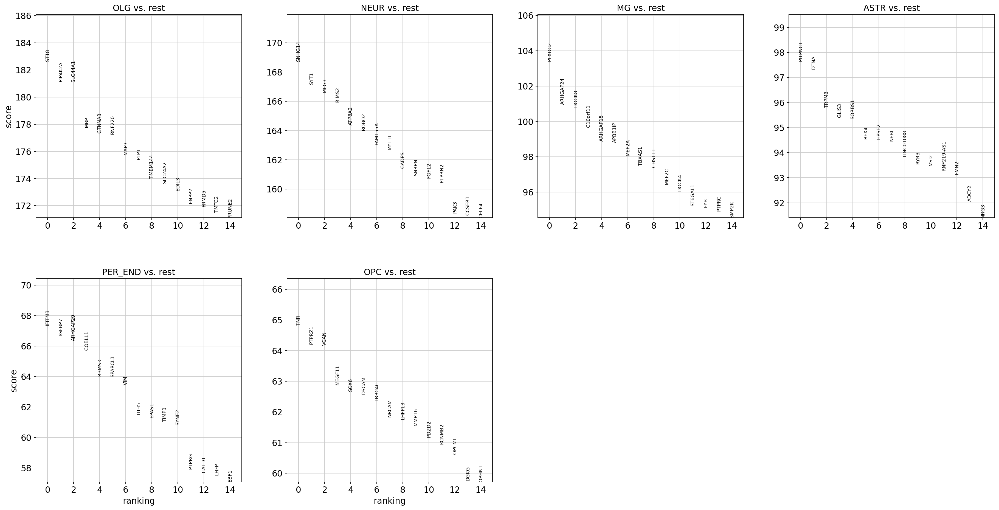

In [873]:
sc.tl.rank_genes_groups(adata, 'leiden_res.0.005', method='wilcoxon', key_added = "wilcoxon")
sc.pl.rank_genes_groups(adata, n_genes=15, sharey=False, key="wilcoxon")

# Microglia (MG) analysis

In [1297]:
genes_MG = sc.get.rank_genes_groups_df(adata, group='MG', key='wilcoxon')['names'][:5]

## GSEA & Functional analysis Microglia

In [1298]:
#Available databases : ‘Human’, ‘Mouse’, ‘Yeast’, ‘Fly’, ‘Fish’, ‘Worm’ 
gene_set_names = gseapy.get_library_name(organism='Human')
print(gene_set_names)

['ARCHS4_Cell-lines', 'ARCHS4_IDG_Coexp', 'ARCHS4_Kinases_Coexp', 'ARCHS4_TFs_Coexp', 'ARCHS4_Tissues', 'Achilles_fitness_decrease', 'Achilles_fitness_increase', 'Aging_Perturbations_from_GEO_down', 'Aging_Perturbations_from_GEO_up', 'Allen_Brain_Atlas_10x_scRNA_2021', 'Allen_Brain_Atlas_down', 'Allen_Brain_Atlas_up', 'Azimuth_Cell_Types_2021', 'BioCarta_2013', 'BioCarta_2015', 'BioCarta_2016', 'BioPlanet_2019', 'BioPlex_2017', 'CCLE_Proteomics_2020', 'CORUM', 'COVID-19_Related_Gene_Sets', 'COVID-19_Related_Gene_Sets_2021', 'Cancer_Cell_Line_Encyclopedia', 'CellMarker_Augmented_2021', 'ChEA_2013', 'ChEA_2015', 'ChEA_2016', 'ChEA_2022', 'Chromosome_Location', 'Chromosome_Location_hg19', 'ClinVar_2019', 'DSigDB', 'Data_Acquisition_Method_Most_Popular_Genes', 'DepMap_WG_CRISPR_Screens_Broad_CellLines_2019', 'DepMap_WG_CRISPR_Screens_Sanger_CellLines_2019', 'Descartes_Cell_Types_and_Tissue_2021', 'Diabetes_Perturbations_GEO_2022', 'DisGeNET', 'Disease_Perturbations_from_GEO_down', 'Disease

In [1299]:
adata.obs.groupby('leiden_res.0.005')['disease__ontology_label'].value_counts()

leiden_res.0.005  disease__ontology_label
OLG               normal                     11291
                  Parkinson disease           9630
NEUR              normal                      8707
                  Parkinson disease           5154
MG                normal                      2629
                  Parkinson disease           1416
ASTR              normal                      2057
                  Parkinson disease           1647
PER_END           normal                      1269
                  Parkinson disease            757
OPC               normal                       764
                  Parkinson disease            688
Name: disease__ontology_label, dtype: int64

In [1300]:
adata.obs['disease__ontology_label'] = pd.Categorical(adata.obs['disease__ontology_label'], categories=["Parkinson disease", "normal"], ordered=True)
indices = adata.obs.sort_values(['leiden_res.0.005', 'disease__ontology_label']).index
adata = adata[indices,:]

/tmp/ipykernel_1398284/594628404.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['disease__ontology_label'] = pd.Categorical(adata.obs['disease__ontology_label'], categories=["Parkinson disease", "normal"], ordered=True)


In [1301]:
MGdata = adata[adata.obs['leiden_res.0.005'] == "MG"].copy()
MGdata

AnnData object with n_obs × n_vars = 4045 × 4431
    obs: 'biosample_id', 'donor_id', 'disease__ontology_label', 'organ__ontology_label', 'sex', 'Donor_Age', 'Status', 'Cause_of_Death', 'FACS_Classification', 'n_genes', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'leiden_res.0.005'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'scrublet', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'donor_id_colors', 'leiden_res.0.005_colors', 'rank_genes_groups', 'dendrogram_leiden_res.0.005', 'wilcoxon'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'lognorm'
    obsp: 'distances', 'connectivities'

In [1302]:
MGdata.obs.groupby('leiden_res.0.005')['disease__ontology_label'].value_counts()

leiden_res.0.005  disease__ontology_label
MG                normal                     2629
                  Parkinson disease          1416
Name: disease__ontology_label, dtype: int64

In [1303]:
MGdata.obs

,biosample_id,donor_id,disease__ontology_label,organ__ontology_label,sex,Donor_Age,Status,Cause_of_Death,FACS_Classification,n_genes,doublet_score,predicted_doublet,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden,leiden_res.0.005
NAME,,,,,,,,,,,,,,,,,,
pPDsHSrSNxi3887d200429DAPIB_GATGGAGAGCCGATAG-1,pPDsHSrSNxi3887d200429DAPIB,3887,Parkinson disease,substantia nigra pars compacta,male,82,PD,Parkinson's disease,Negative,4000,0.026851,False,4000,8071.0,94.0,1.164664,4,MG
pPDsHSrSNxi3887d200429DAPIB_TTGCTGCTCCTACACC-1,pPDsHSrSNxi3887d200429DAPIB,3887,Parkinson disease,substantia nigra pars compacta,male,82,PD,Parkinson's disease,Negative,5035,0.009460,False,5035,14263.0,97.0,0.680081,4,MG
pPDsHSrSNxi3873d200429DAPIB_AACCCAACACAAGCCC-1,pPDsHSrSNxi3873d200429DAPIB,3873,Parkinson disease,substantia nigra pars compacta,female,76,PD,Parkinson's disease,Negative,2298,0.003224,False,2298,4792.0,32.0,0.667780,13,MG
pPDsHSrSNxi3873d200429DAPIA_CTCTCAGTCCAACACA-1,pPDsHSrSNxi3873d200429DAPIA,3873,Parkinson disease,substantia nigra pars compacta,female,76,PD,Parkinson's disease,Negative,2238,0.005648,False,2237,5022.0,105.0,2.090801,13,MG
pPDsHSrSNxi4560d200429PosE_ATCTTCATCATGGATC-1,pPDsHSrSNxi4560d200429PosE,4560,Parkinson disease,substantia nigra pars compacta,female,83,PD,Parkinson's disease,Positive,1628,0.017834,False,1628,2422.0,177.0,7.308010,13,MG
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
pPDsHSrSNxi3346d200429PosB_AAAGGGCCATCGCTAA-1,pPDsHSrSNxi3346d200429PosB,3346,normal,substantia nigra pars compacta,female,91,Ctrl,Congestive Heart failure,Positive,2180,0.034642,False,2180,3570.0,68.0,1.904762,13,MG
pPDsHSrSNxi3346d200429PosC_CGCAGGTAGATGCCGA-1,pPDsHSrSNxi3346d200429PosC,3346,normal,substantia nigra pars compacta,female,91,Ctrl,Congestive Heart failure,Positive,2046,0.005534,False,2045,3147.0,70.0,2.224341,13,MG
pPDsHSrSNxi3322d200429DAPIB_GGGATCCAGAGGTCAC-1,pPDsHSrSNxi3322d200429DAPIB,3322,normal,substantia nigra pars compacta,female,90,Ctrl,Colon cancer,Negative,3475,0.009039,False,3475,7032.0,122.0,1.734926,4,MG


In [1304]:
import time
t1 = time.time()
res = gseapy.gsea(data=MGdata.to_df().T, # row -> genes, column-> samples
        gene_sets="WikiPathway_2021_Human",
        cls=MGdata.obs.disease__ontology_label,
        permutation_num=1000,
        permutation_type='phenotype',
        outdir=None,
        method='s2n')
t2=time.time()
print(t2-t1)

32.639251470565796


In [1305]:
res.res2d = res.res2d.sort_values(by="NES", ascending=False)

In [1306]:
res.res2d.head(20)

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
14,gsea,Parkin-Ubiquitin Proteasomal System pathway WP...,0.574652,1.76694,0.013672,0.41652,0.345,10/21,13.52%,HSPA6;HSPA1A;HSPA1B;SNCA;CASP1;HSPA1L;GPR37;HS...
18,gsea,NRF2 pathway WP2884,0.453045,1.749665,0.008457,0.240648,0.384,16/53,16.43%,HSP90AA1;DNAJB1;HSP90AB1;SQSTM1;HSPA1A;SLC7A11...
24,gsea,Apoptosis Modulation and Signaling WP1772,0.481139,1.689285,0.006438,0.255335,0.511,20/38,29.02%,BAG3;HSPA1A;NFKBIA;PRKD1;CASP1;BOK;BCL2L11;CAS...
26,gsea,Glucocorticoid Receptor Pathway WP2880,0.479623,1.654523,0.008048,0.244037,0.572,15/33,19.95%,HSP90AA1;PTGES3;MFGE8;CDKN1C;NFKB2;PMP2;PRRG4;...
27,gsea,Nuclear Receptors Meta-Pathway WP2882,0.380667,1.65098,0.002188,0.199297,0.577,44/113,27.42%,HSP90AA1;PTGES3;DNAJB1;HSP90AB1;SQSTM1;HSPA1A;...
30,gsea,Nucleotide-binding Oligomerization Domain (NOD...,0.532012,1.632119,0.029167,0.190685,0.609,8/20,10.74%,HSP90AA1;RIPK2;NFKBIA;CASP1;CASP5;CASP7;NLRP1;...
31,gsea,Aryl Hydrocarbon Receptor Pathway WP2873,0.574093,1.595631,0.036072,0.212403,0.686,5/15,11.92%,HSP90AA1;PTGES3;SLC7A5;NQO1;CYP1B1
32,gsea,p53 transcriptional gene network WP4963,0.480549,1.594527,0.032328,0.187735,0.689,8/26,14.76%,SERPINE1;SLC7A11;NOTCH1;PMAIP1;DRAM1;SESN2;ICA...
37,gsea,Apoptosis WP254,0.453723,1.583547,0.033865,0.177839,0.713,17/31,29.02%,NFKBIA;CASP1;TRAF2;BOK;NFKBIE;BCL2L11;CASP7;PM...
40,gsea,VEGFA-VEGFR2 Signaling Pathway WP3888,0.345156,1.539978,0.014644,0.216395,0.798,47/134,32.50%,HSP90AA1;HSPB1;STIP1;DNAJA1;HSPA1A;SDCBP;P4HA2...


### The Parkin-Ubiquitin Proteasomal System (UPS) pathway

The Parkin-Ubiquitin Proteasomal System (UPS) pathway plays a critical role in the development of Parkinson's disease. This pathway is involved in the degradation of misfolded or damaged proteins in cells, and defects in this pathway have been linked to the accumulation of toxic protein aggregates in the brain, which is a key hallmark of Parkinson's disease.

In healthy individuals, the Parkin-UPS pathway works to identify and remove damaged proteins from cells, helping to maintain the proper function of cells and prevent the accumulation of toxic protein aggregates. However, in individuals with Parkinson's disease, defects in this pathway can lead to the accumulation of toxic protein aggregates, such as alpha-synuclein, in the brain. These protein aggregates are thought to play a major role in the degeneration of brain cells, which leads to the symptoms of Parkinson's disease.

Overall, the Parkin-UPS pathway is an important part of maintaining healthy brain cells and preventing the development of Parkinson's disease. Further research into this pathway may help to identify new therapeutic targets for the treatment of Parkinson's disease.

<AxesSubplot: title={'center': 'Parkin-Ubiquitin Proteasomal System pathway WP2359'}>

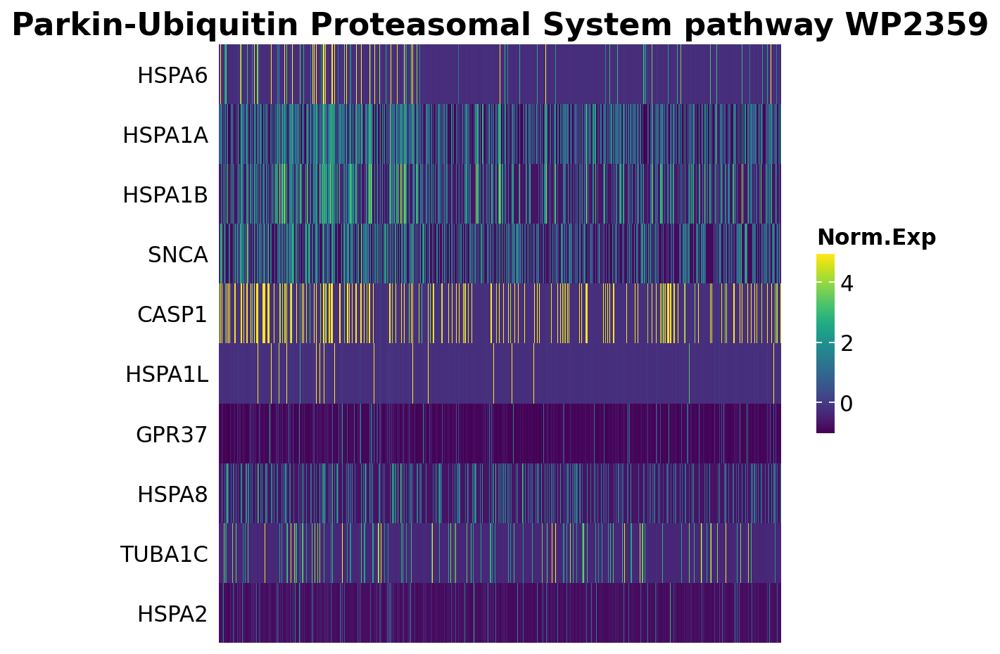

In [1307]:
## Heatmap of gene expression
i = 0
genes = res.res2d.Lead_genes.iloc[i].split(";")
gseapy.heatmap(df = res.heatmat.loc[genes],
           z_score=None,
           title=res.res2d.Term.iloc[i],
           figsize=(8,7),
           cmap=plt.cm.viridis,
           xticklabels=False)

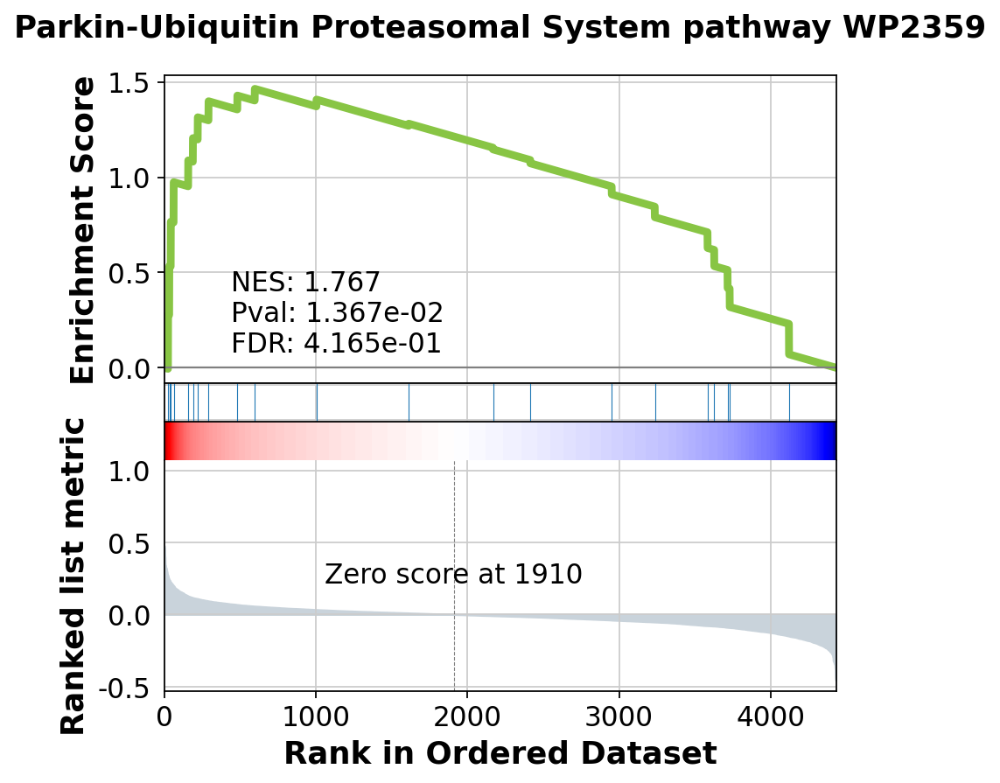

In [1308]:
term = res.res2d.Term.iloc[i]
gseapy.gseaplot(res.ranking, term=term, **res.results[term])

### NRF2 pathway
The NRF2 pathway is a cellular pathway that is involved in the body's response to oxidative stress, which is an imbalance between the production of reactive oxygen species (ROS) and the body's ability to detoxify these harmful molecules. Oxidative stress is thought to play a role in the development of several diseases, including Parkinson's disease.

In the context of Parkinson's disease, the NRF2 pathway is thought to be involved in protecting neurons from damage by ROS. When the body is exposed to oxidative stress, NRF2 is activated and works to upregulate the expression of antioxidant enzymes, which can help to neutralize ROS and protect cells from damage.

However, in individuals with Parkinson's disease, the NRF2 pathway may be impaired, leading to a reduced ability to respond to oxidative stress and protect neurons from damage. This may contribute to the degeneration of brain cells and the development of Parkinson's disease symptoms.

Overall, the NRF2 pathway plays a protective role in the brain, and defects in this pathway may contribute to the development of Parkinson's disease.

<AxesSubplot: title={'center': 'NRF2 pathway WP2884'}>

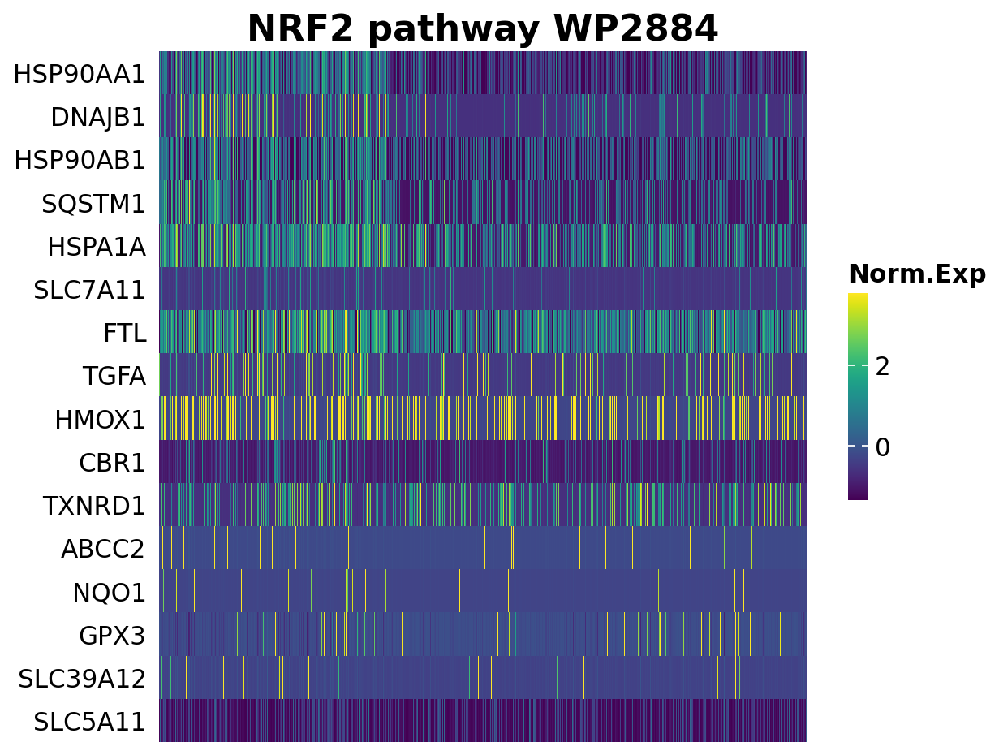

In [1309]:
## Heatmap of gene expression
i = 1
genes = res.res2d.Lead_genes.iloc[i].split(";")
gseapy.heatmap(df = res.heatmat.loc[genes],
           z_score=None,
           title=res.res2d.Term.iloc[i],
           figsize=(8,7),
           cmap=plt.cm.viridis,
           xticklabels=False)

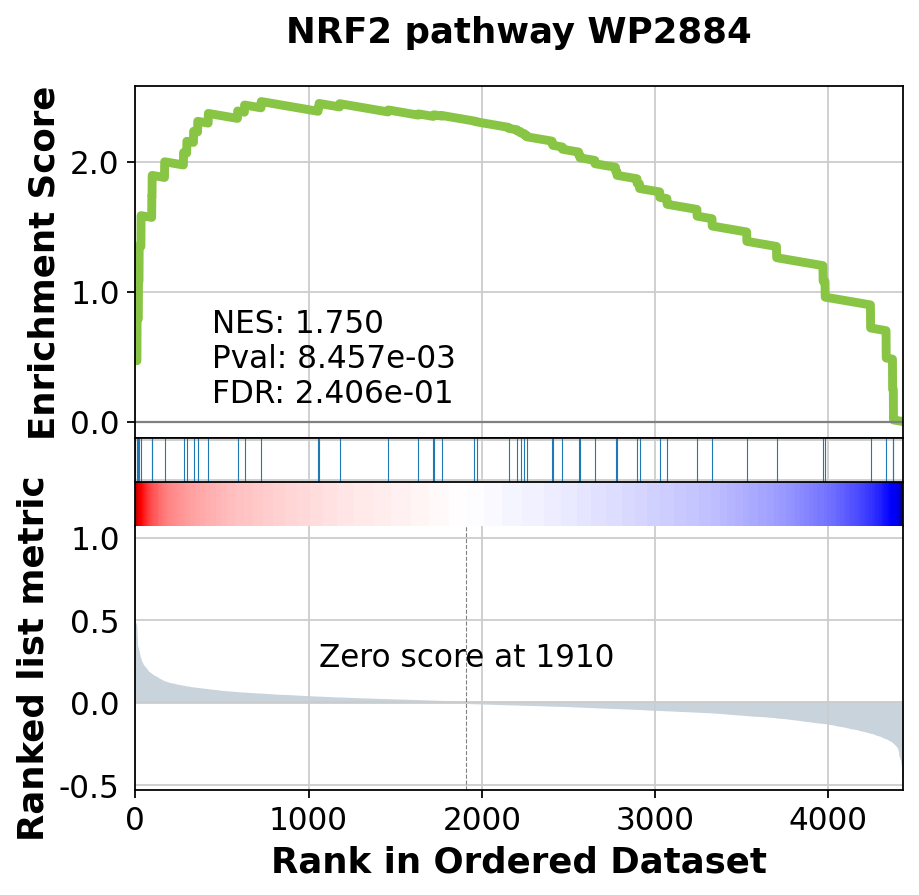

In [1310]:
term = res.res2d.Term.iloc[i]
gseapy.gseaplot(res.ranking, term=term, **res.results[term])

### The Apoptosis Modulation and Signaling pathway
The Apoptosis Modulation and Signaling pathway is involved in regulating the process of apoptosis, or programmed cell death. Apoptosis is a normal and essential process that occurs in the body, and it plays a critical role in maintaining the proper function of cells and tissues.

In the context of Parkinson's disease, the Apoptosis Modulation and Signaling pathway is thought to be involved in the degeneration of brain cells. In Parkinson's disease, the death of neurons in the brain, specifically those in an area called the substantia nigra, leads to the development of the characteristic motor symptoms of the disease.

Research has suggested that defects in the Apoptosis Modulation and Signaling pathway may contribute to the death of neurons in Parkinson's disease. For example, defects in the pathway may lead to the inappropriate activation of pro-apoptotic signaling pathways, which can cause neurons to die prematurely.

<AxesSubplot: title={'center': 'Apoptosis Modulation and Signaling WP1772'}>

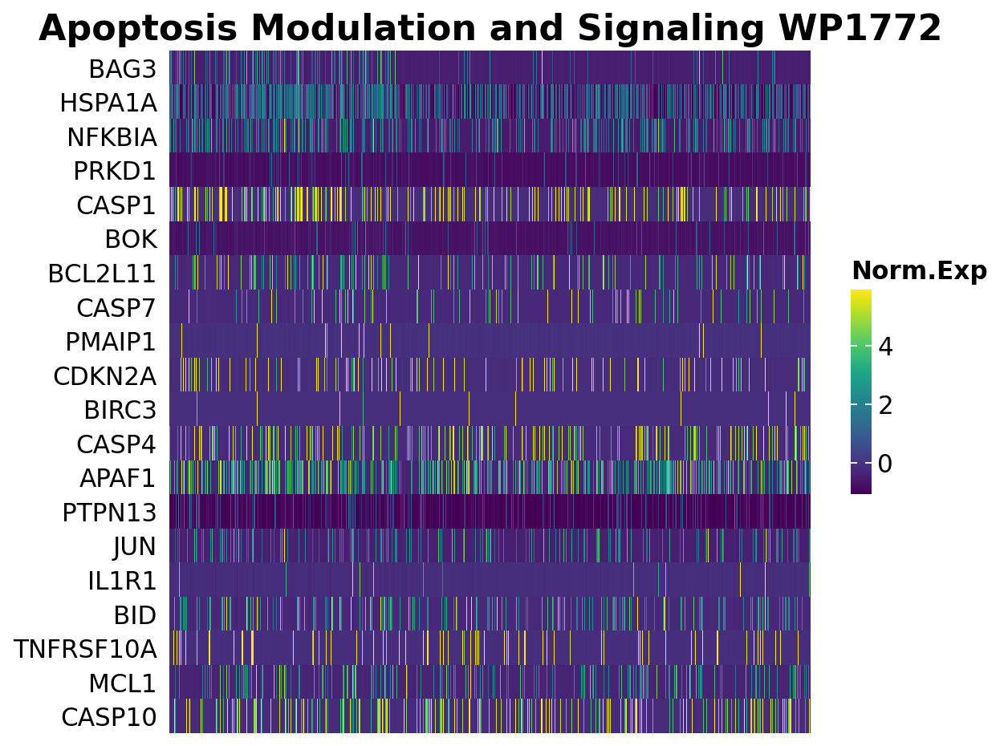

In [1311]:
## Heatmap of gene expression
i = 2
genes = res.res2d.Lead_genes.iloc[i].split(";")
gseapy.heatmap(df = res.heatmat.loc[genes],
           z_score=None,
           title=res.res2d.Term.iloc[i],
           figsize=(8,7),
           cmap=plt.cm.viridis,
           xticklabels=False)

### The Glucocorticoid Receptor Pathway

The Glucocorticoid Receptor Pathway is a signaling pathway that is activated by hormones called glucocorticoids, which are produced by the adrenal gland. Glucocorticoids play a critical role in the body's response to stress and play a number of important physiological roles, including regulating metabolism and the immune system.

In the context of Parkinson's disease, the Glucocorticoid Receptor Pathway is thought to be involved in the death of neurons in the brain. In Parkinson's disease, the death of neurons in an area of the brain called the substantia nigra leads to the development of the characteristic motor symptoms of the disease.

Research has suggested that glucocorticoids may play a role in the death of neurons in Parkinson's disease. For example, high levels of glucocorticoids have been linked to an increased risk of developing Parkinson's disease, and glucocorticoids have been shown to induce the death of neurons in animal models of the disease.

Overall, the Glucocorticoid Receptor Pathway is thought to be involved in the death of neurons in Parkinson's disease.

<AxesSubplot: title={'center': 'Glucocorticoid Receptor Pathway WP2880'}>

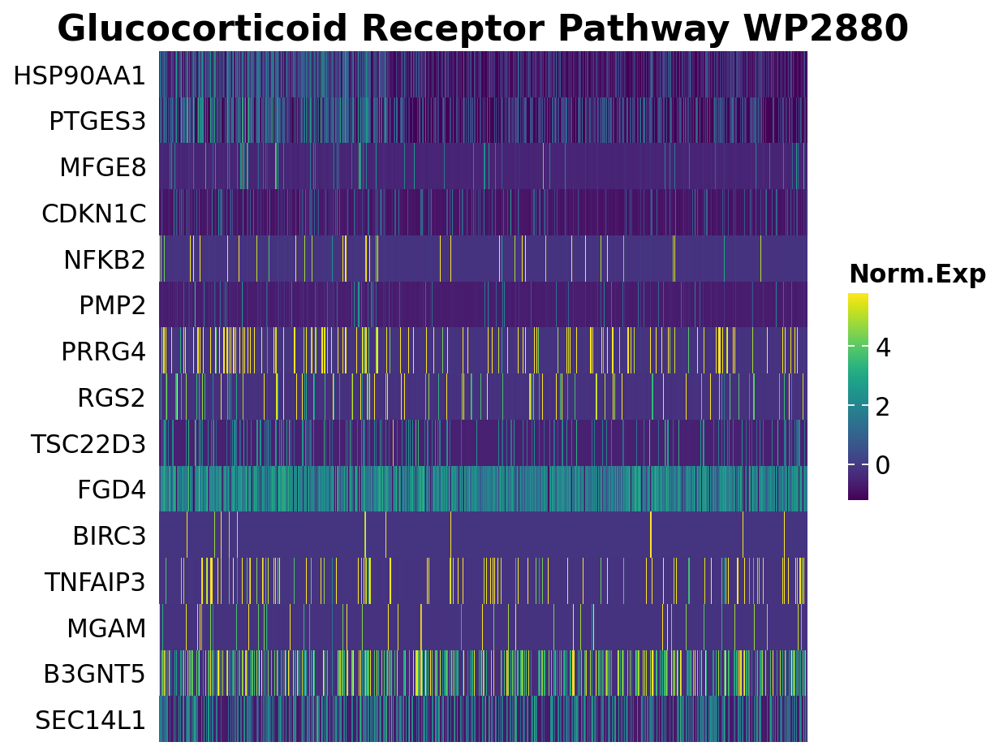

In [1312]:
## Heatmap of gene expression
i = 3
genes = res.res2d.Lead_genes.iloc[i].split(";")
gseapy.heatmap(df = res.heatmat.loc[genes],
           z_score=None,
           title=res.res2d.Term.iloc[i],
           figsize=(8,7),
           cmap=plt.cm.viridis,
           xticklabels=False)

### VEGFA-VEGFR2 Signaling Pathway

In the context of Parkinson's disease, the VEGFA-VEGFR2 Signaling Pathway is thought to play a role in the degeneration of neurons in the brain. Research has suggested that defects in the VEGFA-VEGFR2 Signaling Pathway may contribute to the death of neurons in Parkinson's disease. For example, studies have shown that inhibiting the VEGFA-VEGFR2 pathway can protect neurons from death in animal models of Parkinson's disease. Additionally, genetic variations in the VEGFA gene have been associated with an increased risk of developing Parkinson's disease.

<AxesSubplot: title={'center': 'VEGFA-VEGFR2 Signaling Pathway WP3888'}>

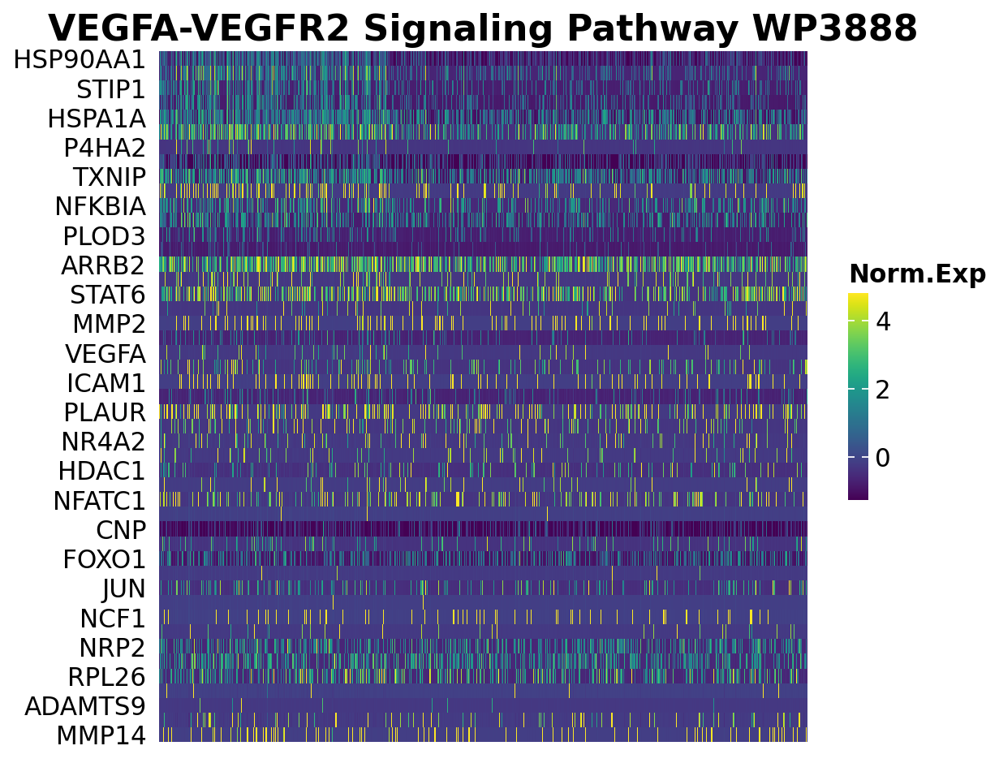

In [1318]:
## Heatmap of gene expression
i = 9
genes = res.res2d.Lead_genes.iloc[i].split(";")
gseapy.heatmap(df = res.heatmat.loc[genes],
           z_score=None,
           title=res.res2d.Term.iloc[i],
           figsize=(8,7),
           cmap=plt.cm.viridis,
           xticklabels=False)

## DEG Analysis Acros Condidtion (PD vs Ctrl) in Microglia

In [1212]:
# find degs
sc.tl.rank_genes_groups(MGdata,
                        groupby='disease__ontology_label',
                        use_raw=False,
                        layer='lognorm',
                        method='wilcoxon',
                        groups=["Parkinson disease"],
                        reference='normal')

In [1213]:
MGdata.X.max()

10.0

In [1214]:
MGdata.X.min()

-3.3146126

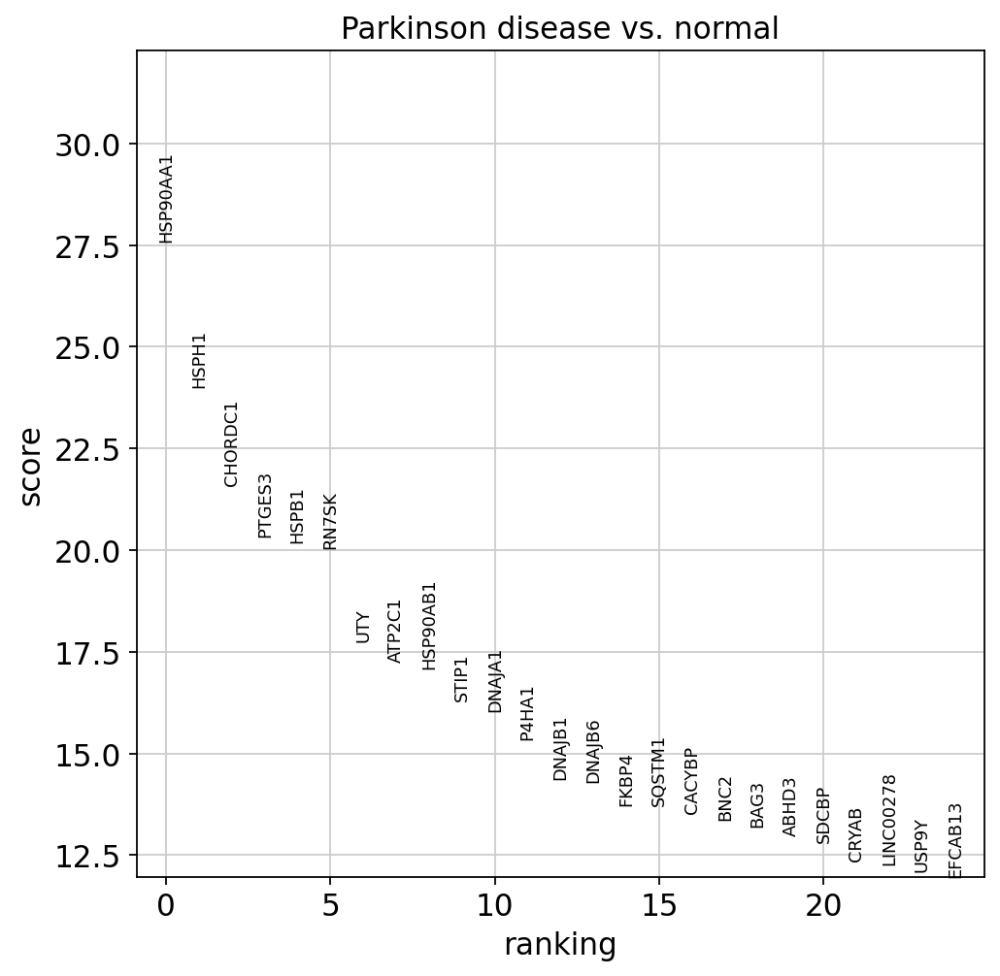

In [1215]:
sc.pl.rank_genes_groups(MGdata, n_genes=25, sharey=False)

In [1216]:
# get deg result
result = MGdata.uns['rank_genes_groups']
groups = result['names'].dtype.names
degs = pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','pvals_adj','logfoldchanges']})

In [1217]:
degs.head(10)

,Parkinson disease_names,Parkinson disease_scores,Parkinson disease_pvals,Parkinson disease_pvals_adj,Parkinson disease_logfoldchanges
0,HSP90AA1,27.589228,1.498478e-167,6.639756e-164,1.763506
1,HSPH1,24.003187,2.575664e-127,5.706384e-124,2.266003
2,CHORDC1,21.591211,2.172457e-103,1.925231e-100,2.256648
3,PTGES3,20.340414,5.645195e-92,3.126732e-89,1.573559
4,HSPB1,20.189573,1.209030e-90,5.952459e-88,2.135524
5,RN7SK,20.035854,2.681970e-89,1.188381e-86,2.243765
6,UTY,17.754692,1.585375e-70,4.132232e-68,2.864583
7,ATP2C1,17.246567,1.187508e-66,2.923250e-64,1.032329
8,HSP90AB1,17.082657,1.998088e-65,4.659751e-63,1.225423
9,STIP1,16.307089,8.788256e-60,1.770035e-57,1.758014


In [1218]:
degs = degs[degs['Parkinson disease_pvals_adj'] < 0.05] # keep only statistically significant genes

### Top 15 differentially upregulated genes

In [1219]:
degs.sort_values(by="Parkinson disease_logfoldchanges", ascending=False).head(15)

,Parkinson disease_names,Parkinson disease_scores,Parkinson disease_pvals,Parkinson disease_pvals_adj,Parkinson disease_logfoldchanges
167,PNLDC1,4.367692,1.255667e-05,1.011611e-04,4.265349
85,HSPE1-MOB4,7.125889,1.034112e-12,1.742262e-11,3.956627
37,DDX3Y,10.498963,8.733393e-26,3.365014e-24,3.349814
168,P4HA2,4.352054,1.348679e-05,1.080650e-04,3.085999
206,TNFSF14,3.861104,1.128760e-04,7.839397e-04,3.037423
150,ZFY,4.765722,1.881788e-06,1.729918e-05,3.032551
344,CYP39A1,2.551342,1.073088e-02,4.643413e-02,3.013410
6,UTY,17.754692,1.585375e-70,4.132232e-68,2.864583
66,C5orf17,8.147927,3.702145e-16,8.120893e-15,2.864483
46,C15orf26,9.277126,1.741109e-20,5.284148e-19,2.828282


### Top 15 differentially downregulated genes

In [1220]:
degs.sort_values(by="Parkinson disease_logfoldchanges", ascending=True).head(15) # top 15 differentially downregulated genes

,Parkinson disease_names,Parkinson disease_scores,Parkinson disease_pvals,Parkinson disease_pvals_adj,Parkinson disease_logfoldchanges
4149,LINC00977,-5.339107,9.340573e-08,9.949057e-07,-3.900563
4300,TSIX,-8.314956,9.178686e-17,2.075039e-15,-3.286098
4423,CCDC26,-19.053587,6.135139e-81,1.941771e-78,-3.033798
4420,HAMP,-17.012346,6.651999e-65,1.473750e-62,-3.003777
3807,NPFFR1,-2.780439,5.428538e-03,2.580885e-02,-2.936552
4425,TMEM163,-19.437588,3.712106e-84,1.370695e-81,-2.788443
3879,CTC-436P18.3,-3.125899,1.772626e-03,9.578668e-03,-2.519014
4056,SELL,-4.419981,9.870989e-06,8.129805e-05,-2.387363
3848,SLC18A2,-2.981875,2.864889e-03,1.472660e-02,-2.245057
3890,CH25H,-3.221430,1.275527e-03,7.056004e-03,-2.222887


#### Over-representation analysis (Enrichr API)

In [1221]:
# subset up or down regulated genes
degs_sig = degs[degs['Parkinson disease_pvals_adj'] < 0.05]
degs_up = degs_sig[degs_sig['Parkinson disease_logfoldchanges'] > 0]
degs_dw = degs_sig[degs_sig['Parkinson disease_logfoldchanges'] < 0]

In [1222]:
degs_up.shape

(351, 5)

In [1223]:
degs_dw.shape

(688, 5)

In [1224]:
# Enricr API - GO_Biological_Process_2021
enr_up = gseapy.enrichr(degs_up['Parkinson disease_names'],
                    gene_sets='GO_Biological_Process_2021',
                    outdir=None)

In [1225]:
# trim (go:...)
enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]

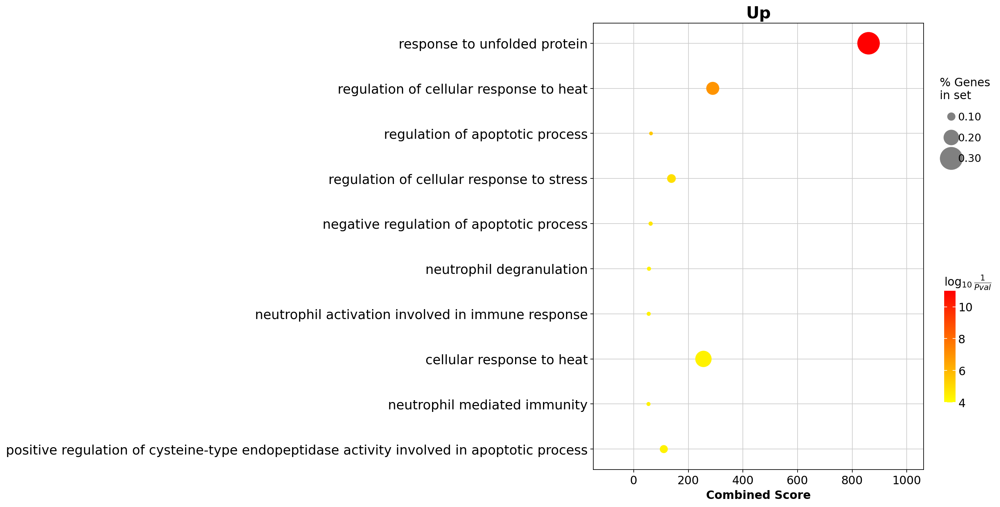

In [1226]:
# dotplot
gseapy.plot.dotplot(enr_up.res2d, figsize=(9,10), title="Up", cmap = plt.cm.autumn_r, size = 15)
plt.show()

In [1227]:
enr_dw = gseapy.enrichr(degs_dw['Parkinson disease_names'],
                    gene_sets='GO_Biological_Process_2021',
                    outdir=None)

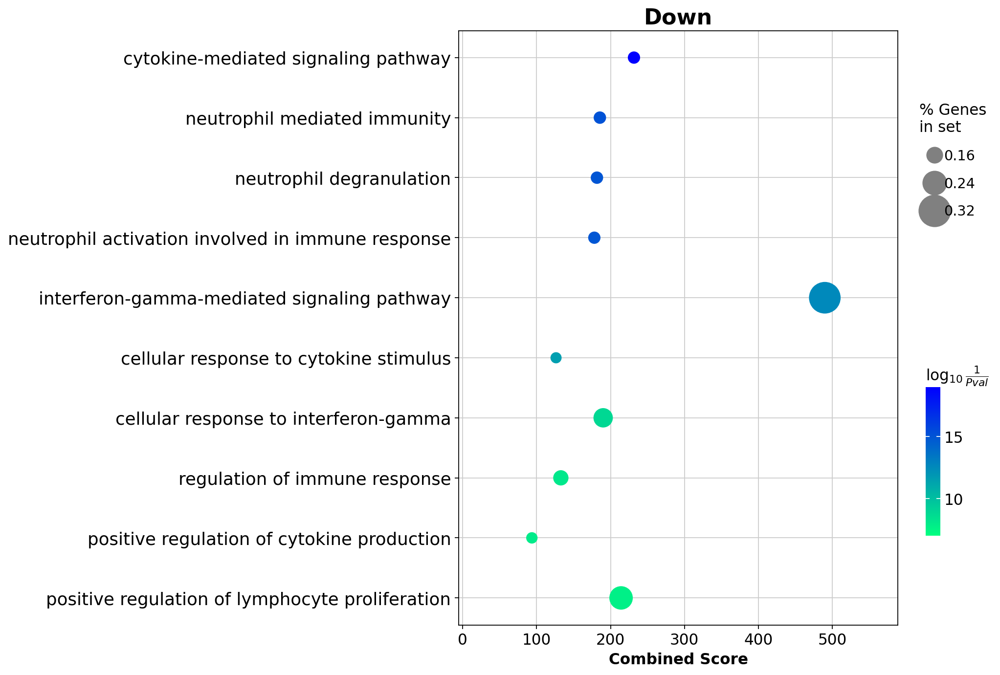

In [1228]:
enr_dw.res2d.Term = enr_dw.res2d.Term.str.split(" \(GO").str[0]
gseapy.dotplot(enr_dw.res2d,
           figsize=(9,10),
           title="Down",
           cmap = plt.cm.winter_r,
           size=15)
plt.show()

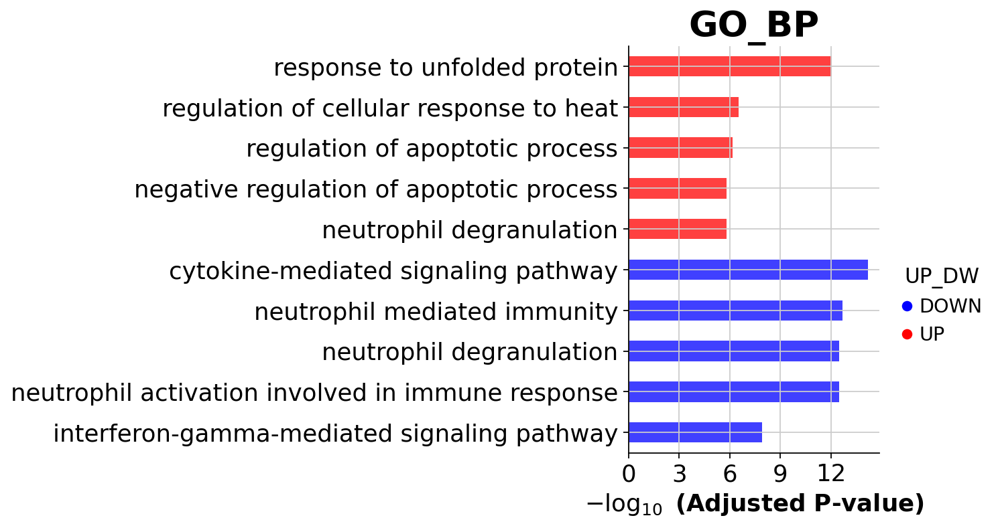

In [1229]:
ax = gseapy.barplot(enr_res, figsize=(3,5),
                group ='UP_DW',
                title ="GO_BP",
                color = ['b','r'])

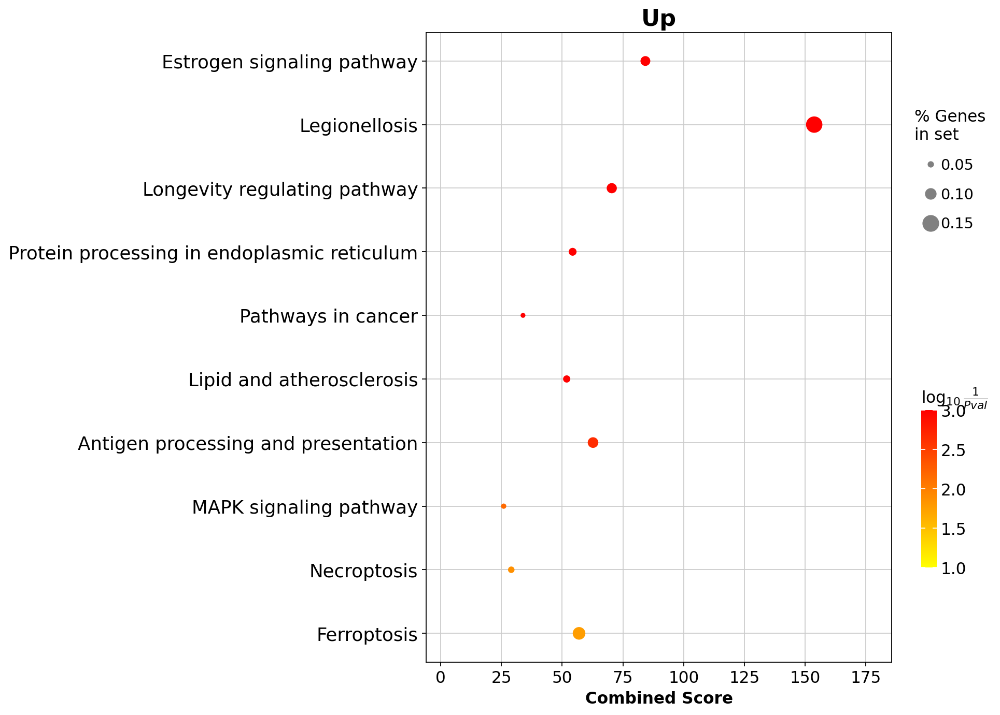

In [1230]:
# Enricr API - KEGG_2021_Human
enr_up = gseapy.enrichr(degs_up['Parkinson disease_names'],
                    gene_sets='KEGG_2021_Human',
                    outdir=None)

enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]

# dotplot
gseapy.plot.dotplot(enr_up.res2d, figsize=(9,10), title="Up", cmap = plt.cm.autumn_r, size = 15)
plt.show()

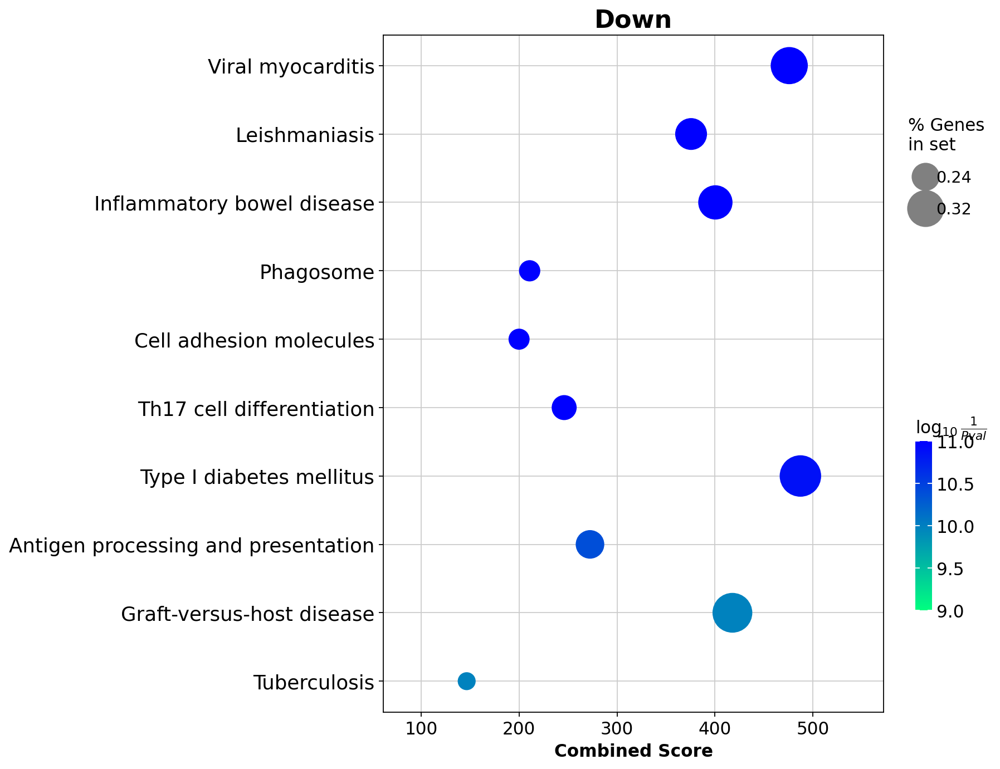

In [1231]:
enr_dw = gseapy.enrichr(degs_dw['Parkinson disease_names'],
                    gene_sets='KEGG_2021_Human',
                    outdir=None)

enr_dw.res2d.Term = enr_dw.res2d.Term.str.split(" \(GO").str[0]

gseapy.dotplot(enr_dw.res2d,
           figsize=(9,10),
           title="Down",
           cmap = plt.cm.winter_r,
           size=15)
plt.show()

### Network Visualization in Microglia

Based on the occurences in Lead_genes

In [1232]:
import networkx as nx

In [1233]:
res.res2d.head()

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
14,gsea,Parkin-Ubiquitin Proteasomal System pathway WP...,0.574652,1.76694,0.013672,0.41652,0.345,10/21,13.52%,HSPA6;HSPA1A;HSPA1B;SNCA;CASP1;HSPA1L;GPR37;HS...
18,gsea,NRF2 pathway WP2884,0.453045,1.749665,0.008457,0.240648,0.384,16/53,16.43%,HSP90AA1;DNAJB1;HSP90AB1;SQSTM1;HSPA1A;SLC7A11...
24,gsea,Apoptosis Modulation and Signaling WP1772,0.481139,1.689285,0.006438,0.255335,0.511,20/38,29.02%,BAG3;HSPA1A;NFKBIA;PRKD1;CASP1;BOK;BCL2L11;CAS...
26,gsea,Glucocorticoid Receptor Pathway WP2880,0.479623,1.654523,0.008048,0.244037,0.572,15/33,19.95%,HSP90AA1;PTGES3;MFGE8;CDKN1C;NFKB2;PMP2;PRRG4;...
27,gsea,Nuclear Receptors Meta-Pathway WP2882,0.380667,1.65098,0.002188,0.199297,0.577,44/113,27.42%,HSP90AA1;PTGES3;DNAJB1;HSP90AB1;SQSTM1;HSPA1A;...


In [1234]:
from gseapy import enrichment_map
nodes, edges = gseapy.enrichment_map(res.res2d, column='NES')

In [1235]:
nodes.head()

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes,Hits_ratio
node_idx,,,,,,,,,,,
0,gsea,VEGFA-VEGFR2 Signaling Pathway WP3888,0.345156,1.539978,0.014644,0.216395,0.798,47/134,32.50%,HSP90AA1;HSPB1;STIP1;DNAJA1;HSPA1A;SDCBP;P4HA2...,0.350746
1,gsea,Apoptosis WP254,0.453723,1.583547,0.033865,0.177839,0.713,17/31,29.02%,NFKBIA;CASP1;TRAF2;BOK;NFKBIE;BCL2L11;CASP7;PM...,0.548387
2,gsea,p53 transcriptional gene network WP4963,0.480549,1.594527,0.032328,0.187735,0.689,8/26,14.76%,SERPINE1;SLC7A11;NOTCH1;PMAIP1;DRAM1;SESN2;ICA...,0.307692
3,gsea,Aryl Hydrocarbon Receptor Pathway WP2873,0.574093,1.595631,0.036072,0.212403,0.686,5/15,11.92%,HSP90AA1;PTGES3;SLC7A5;NQO1;CYP1B1,0.333333
4,gsea,Nucleotide-binding Oligomerization Domain (NOD...,0.532012,1.632119,0.029167,0.190685,0.609,8/20,10.74%,HSP90AA1;RIPK2;NFKBIA;CASP1;CASP5;CASP7;NLRP1;...,0.400000


In [1236]:
edges.head()

,src_idx,targ_idx,src_name,targ_name,jaccard_coef,overlap_coef,overlap_genes
0,0,1,VEGFA-VEGFR2 Signaling Pathway WP3888,Apoptosis WP254,0.032258,0.117647,"NFKBIA,JUN"
1,0,2,VEGFA-VEGFR2 Signaling Pathway WP3888,p53 transcriptional gene network WP4963,0.018519,0.125000,ICAM1
2,0,3,VEGFA-VEGFR2 Signaling Pathway WP3888,Aryl Hydrocarbon Receptor Pathway WP2873,0.019608,0.200000,HSP90AA1
3,0,4,VEGFA-VEGFR2 Signaling Pathway WP3888,Nucleotide-binding Oligomerization Domain (NOD...,0.037736,0.250000,"HSP90AA1,NFKBIA"
4,0,5,VEGFA-VEGFR2 Signaling Pathway WP3888,Nuclear Receptors Meta-Pathway WP2882,0.058140,0.113636,"HSP90AA1,JUN,FOXO1,ACKR3,HSPA1A"


In [1237]:
# build graph
G = nx.from_pandas_edgelist(edges,
                            source='src_idx',
                            target='targ_idx',
                            edge_attr=['jaccard_coef', 'overlap_coef', 'overlap_genes'])

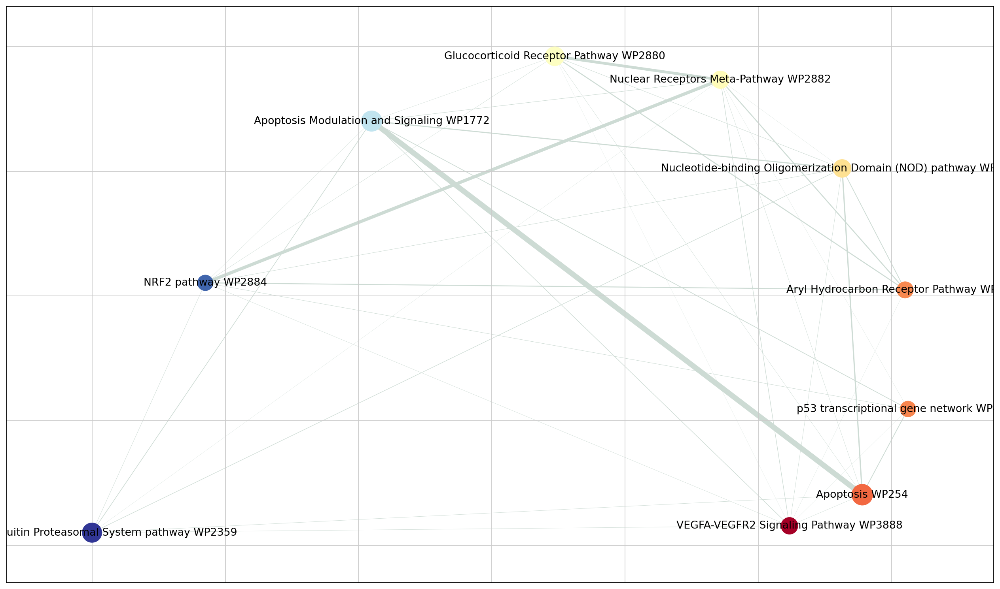

In [1238]:
fig, ax = plt.subplots(figsize=(20,12))

# init node cooridnates
pos=nx.layout.spiral_layout(G)
#node_size = nx.get_node_attributes()
# draw node
nx.draw_networkx_nodes(G,
                       pos=pos,
                       cmap=plt.cm.RdYlBu,
                       node_color=list(nodes.NES),
                       node_size=list(nodes.Hits_ratio *1000))
# draw node label
nx.draw_networkx_labels(G,
                        pos=pos,
                        labels=nodes.Term.to_dict())
# draw edge
edge_weight = nx.get_edge_attributes(G, 'jaccard_coef').values()
nx.draw_networkx_edges(G,
                       pos=pos,
                       width=list(map(lambda x: x*10, edge_weight)),
                       edge_color='#CDDBD4')
plt.show()

# Neurons (NEUR) analysis

In [1321]:
genes_NEUR = sc.get.rank_genes_groups_df(adata, group='NEUR', key='wilcoxon')['names'][:5]

## GSEA & Functional analysis - Neurons

In [1322]:
#Available databases : ‘Human’, ‘Mouse’, ‘Yeast’, ‘Fly’, ‘Fish’, ‘Worm’ 
gene_set_names = gseapy.get_library_name(organism='Human')
print(gene_set_names)

['ARCHS4_Cell-lines', 'ARCHS4_IDG_Coexp', 'ARCHS4_Kinases_Coexp', 'ARCHS4_TFs_Coexp', 'ARCHS4_Tissues', 'Achilles_fitness_decrease', 'Achilles_fitness_increase', 'Aging_Perturbations_from_GEO_down', 'Aging_Perturbations_from_GEO_up', 'Allen_Brain_Atlas_10x_scRNA_2021', 'Allen_Brain_Atlas_down', 'Allen_Brain_Atlas_up', 'Azimuth_Cell_Types_2021', 'BioCarta_2013', 'BioCarta_2015', 'BioCarta_2016', 'BioPlanet_2019', 'BioPlex_2017', 'CCLE_Proteomics_2020', 'CORUM', 'COVID-19_Related_Gene_Sets', 'COVID-19_Related_Gene_Sets_2021', 'Cancer_Cell_Line_Encyclopedia', 'CellMarker_Augmented_2021', 'ChEA_2013', 'ChEA_2015', 'ChEA_2016', 'ChEA_2022', 'Chromosome_Location', 'Chromosome_Location_hg19', 'ClinVar_2019', 'DSigDB', 'Data_Acquisition_Method_Most_Popular_Genes', 'DepMap_WG_CRISPR_Screens_Broad_CellLines_2019', 'DepMap_WG_CRISPR_Screens_Sanger_CellLines_2019', 'Descartes_Cell_Types_and_Tissue_2021', 'Diabetes_Perturbations_GEO_2022', 'DisGeNET', 'Disease_Perturbations_from_GEO_down', 'Disease

In [1323]:
adata.obs.groupby('leiden_res.0.005')['disease__ontology_label'].value_counts()

leiden_res.0.005  disease__ontology_label
OLG               normal                     11291
                  Parkinson disease           9630
NEUR              normal                      8707
                  Parkinson disease           5154
MG                normal                      2629
                  Parkinson disease           1416
ASTR              normal                      2057
                  Parkinson disease           1647
PER_END           normal                      1269
                  Parkinson disease            757
OPC               normal                       764
                  Parkinson disease            688
Name: disease__ontology_label, dtype: int64

In [1324]:
adata.obs['disease__ontology_label'] = pd.Categorical(adata.obs['disease__ontology_label'], categories=["Parkinson disease", "normal"], ordered=True)
indices = adata.obs.sort_values(['leiden_res.0.005', 'disease__ontology_label']).index
adata = adata[indices,:]

/tmp/ipykernel_1398284/594628404.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['disease__ontology_label'] = pd.Categorical(adata.obs['disease__ontology_label'], categories=["Parkinson disease", "normal"], ordered=True)


In [1325]:
NEURdata = adata[adata.obs['leiden_res.0.005'] == "NEUR"].copy()
NEURdata

AnnData object with n_obs × n_vars = 13861 × 4431
    obs: 'biosample_id', 'donor_id', 'disease__ontology_label', 'organ__ontology_label', 'sex', 'Donor_Age', 'Status', 'Cause_of_Death', 'FACS_Classification', 'n_genes', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'leiden_res.0.005'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'scrublet', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'donor_id_colors', 'leiden_res.0.005_colors', 'rank_genes_groups', 'dendrogram_leiden_res.0.005', 'wilcoxon'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'lognorm'
    obsp: 'distances', 'connectivities'

In [1326]:
NEURdata.obs.groupby('leiden_res.0.005')['disease__ontology_label'].value_counts()

leiden_res.0.005  disease__ontology_label
NEUR              normal                     8707
                  Parkinson disease          5154
Name: disease__ontology_label, dtype: int64

In [1327]:
NEURdata.obs

,biosample_id,donor_id,disease__ontology_label,organ__ontology_label,sex,Donor_Age,Status,Cause_of_Death,FACS_Classification,n_genes,doublet_score,predicted_doublet,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden,leiden_res.0.005
NAME,,,,,,,,,,,,,,,,,,
pPDsHSrSNxi4560d200429PosC_CCTGCATTCGGTCGAC-1,pPDsHSrSNxi4560d200429PosC,4560,Parkinson disease,substantia nigra pars compacta,female,83,PD,Parkinson's disease,Positive,3208,0.008901,False,3208,6931.0,192.0,2.770163,16,NEUR
pPDsHSrSNxi4560d200429PosE_GCACATAGTGAAAGTT-1,pPDsHSrSNxi4560d200429PosE,4560,Parkinson disease,substantia nigra pars compacta,female,83,PD,Parkinson's disease,Positive,5121,0.005422,False,5120,15451.0,328.0,2.122840,16,NEUR
pPDsHSrSNxi4568d200429PosB_CAATGACGTGATTCTG-1,pPDsHSrSNxi4568d200429PosB,4568,Parkinson disease,substantia nigra pars compacta,male,78,PD,Parkinson's disease,Positive,4519,0.005199,False,4518,14020.0,555.0,3.958631,22,NEUR
pPDsHSrSNxi3873d200429PosB_GTGCACGTCGCAATGT-1,pPDsHSrSNxi3873d200429PosB,3873,Parkinson disease,substantia nigra pars compacta,female,76,PD,Parkinson's disease,Positive,9442,0.006345,False,9441,59299.0,4882.0,8.232854,24,NEUR
pPDsHSrSNxi4560d200429PosD_GTGCTGGTCTCGTGGG-1,pPDsHSrSNxi4560d200429PosD,4560,Parkinson disease,substantia nigra pars compacta,female,83,PD,Parkinson's disease,Positive,6113,0.014279,False,6110,19923.0,1723.0,8.648295,16,NEUR
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
pPDsHSrSNxi3322d200429PosF_AGCTACAAGTAGAATC-1,pPDsHSrSNxi3322d200429PosF,3322,normal,substantia nigra pars compacta,female,90,Ctrl,Colon cancer,Positive,5768,0.007322,False,5768,22639.0,210.0,0.927603,3,NEUR
pPDsHSrSNxi3346d200429PosC_GCCATGGGTTCCACAA-1,pPDsHSrSNxi3346d200429PosC,3346,normal,substantia nigra pars compacta,female,91,Ctrl,Congestive Heart failure,Positive,7291,0.012874,False,7289,40215.0,185.0,0.460027,9,NEUR
pPDsHSrSNxi4956d200429PosA_TGAGTCATCACGATAC-1,pPDsHSrSNxi4956d200429PosA,4956,normal,substantia nigra pars compacta,female,92,Ctrl,Prostate cancer,Positive,6407,0.001652,False,6406,34071.0,244.0,0.716152,14,NEUR


In [1328]:
import time
t1 = time.time()
res = gseapy.gsea(data=NEURdata.to_df().T, # row -> genes, column-> samples
        gene_sets="WikiPathway_2021_Human",
        cls=NEURdata.obs.disease__ontology_label,
        permutation_num=1000,
        permutation_type='phenotype',
        outdir=None,
        method='s2n')
t2=time.time()
print(t2-t1)

155.0745394229889


In [1329]:
res.res2d = res.res2d.sort_values(by="NES", ascending=False)

In [1330]:
res.res2d.head(20)

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,gsea,Neural Crest Differentiation WP2064,0.517002,1.773906,0.004024,0.665174,0.264,23/38,33.36%,OLIG1;OLIG2;SMAD1;FGFR3;SOX5;RHOB;NOTCH1;TCF7L...
1,gsea,Cardiac Progenitor Differentiation WP2406,0.604067,1.756582,0.00611,0.400535,0.298,8/17,20.54%,SOX2;PDGFRA;NOTCH1;BMP1;CXCR4;BMP4;THY1;FGF2
2,gsea,B Cell Receptor Signaling Pathway WP23,0.583023,1.733088,0.008421,0.3457,0.348,19/35,21.21%,BCL6;CD22;RASGRP3;FOXO1;LAT2;SYK;BLNK;INPP5D;L...
3,gsea,Oligodendrocyte specification and differentiat...,0.629804,1.726404,0.01875,0.274474,0.365,10/17,20.54%,OLIG1;OLIG2;MAG;CNP;SOX8;SOX5;GLI2;BMP4;SOX9;FGF2
4,gsea,IL-3 signaling pathway WP286,0.636691,1.709088,0.006356,0.259633,0.407,11/18,24.22%,SYK;CD86;INPP5D;LYN;BCL2;CD69;PTPN6;HCK;IL3RA;...
5,gsea,Oxidative Damage WP3941,0.623556,1.678483,0.016064,0.299507,0.486,9/16,24.53%,CDKN1C;BCL2;TRAF2;C5AR1;C1QB;C1QC;C3AR1;C1QA;C1S
6,gsea,Aryl Hydrocarbon Receptor Pathway WP2873,0.602399,1.647909,0.024793,0.336163,0.556,5/15,15.78%,PTGES3;HSP90AA1;CAP2;SLC7A5;EGFR
8,gsea,Aryl Hydrocarbon Receptor Netpath WP2586,0.564247,1.60725,0.036017,0.40277,0.636,5/15,18.66%,HSP90AA1;PSRC1;VEGFA;EGFR;HPGDS
9,gsea,Endochondral Ossification with Skeletal Dyspla...,0.456863,1.606893,0.012552,0.32311,0.636,14/33,21.87%,CDKN1C;SPP1;ADAMTS4;SERPINH1;CALM1;FGFR3;SOX5;...
10,gsea,Endochondral Ossification WP474,0.456863,1.606893,0.012552,0.32311,0.636,14/33,21.87%,CDKN1C;SPP1;ADAMTS4;SERPINH1;CALM1;FGFR3;SOX5;...


### Aryl Hydrocarbon Receptor Pathway

In the context of Parkinson's disease, the Aryl Hydrocarbon Receptor Pathway is thought to play a role in the death of neurons in the brain. Research has suggested that exposure to aryl hydrocarbons may increase the risk of developing Parkinson's disease. For example, studies have shown that individuals who are exposed to high levels of aryl hydrocarbons, such as those who work in certain industrial settings, have an increased risk of developing Parkinson's disease. Additionally, activating the Aryl Hydrocarbon Receptor Pathway has been shown to induce the death of neurons in animal models of Parkinson's disease.

<AxesSubplot: title={'center': 'Aryl Hydrocarbon Receptor Netpath WP2586'}>

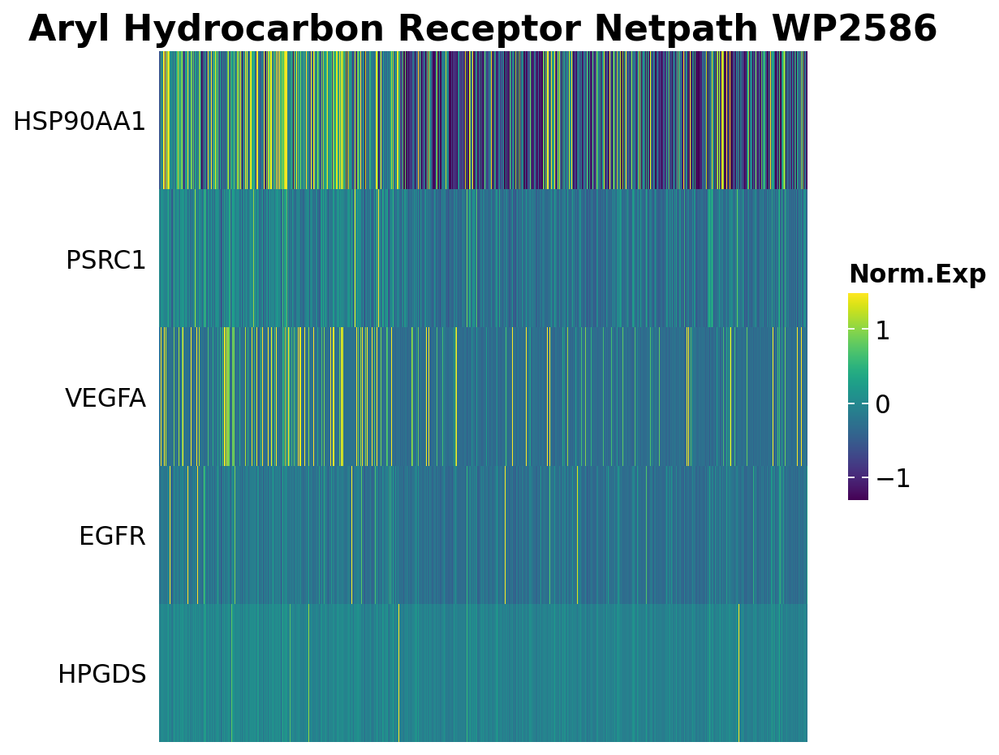

In [1331]:
## Heatmap of gene expression
i = 7
genes = res.res2d.Lead_genes.iloc[i].split(";")
gseapy.heatmap(df = res.heatmat.loc[genes],
           z_score=None,
           title=res.res2d.Term.iloc[i],
           figsize=(8,7),
           cmap=plt.cm.viridis,
           xticklabels=False)

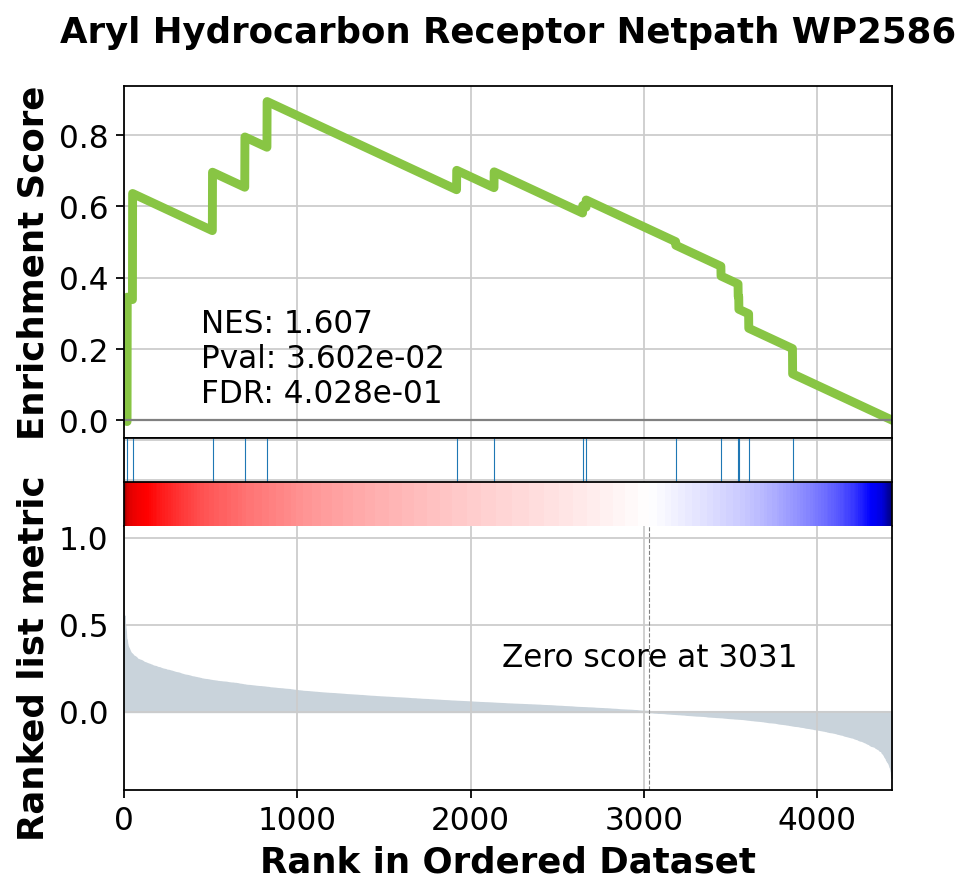

In [1332]:
term = res.res2d.Term.iloc[i]
gseapy.gseaplot(res.ranking, term=term, **res.results[term])

## DEG Analysis Acros Condidtion (PD vs Ctrl) in Neurons

In [1334]:
# find degs
sc.tl.rank_genes_groups(NEURdata,
                        groupby='disease__ontology_label',
                        use_raw=False,
                        layer='lognorm',
                        method='wilcoxon',
                        groups=["Parkinson disease"],
                        reference='normal')

In [1335]:
NEURdata.X.max()

10.0

In [1336]:
NEURdata.X.min()

-5.946922

In [1337]:
# get deg result
result = NEURdata.uns['rank_genes_groups']
groups = result['names'].dtype.names
degs = pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','pvals_adj','logfoldchanges']})

In [1338]:
degs.head(10)

,Parkinson disease_names,Parkinson disease_scores,Parkinson disease_pvals,Parkinson disease_pvals_adj,Parkinson disease_logfoldchanges
0,C15orf26,55.297176,0.000000e+00,0.000000e+00,2.211883
1,HSPH1,51.882004,0.000000e+00,0.000000e+00,1.456398
2,ATRNL1,49.921135,0.000000e+00,0.000000e+00,1.135697
3,HSPB1,48.159142,0.000000e+00,0.000000e+00,2.401768
4,DNAJB1,44.240410,0.000000e+00,0.000000e+00,2.117394
5,RUNX1,43.716881,0.000000e+00,0.000000e+00,2.746269
6,HSP90AA1,42.213970,0.000000e+00,0.000000e+00,1.163507
7,CAP2,40.496307,0.000000e+00,0.000000e+00,1.016696
8,DCDC1,39.750172,0.000000e+00,0.000000e+00,1.896919
9,GNAS,37.438477,9.250007e-307,3.415565e-304,0.842726


In [1339]:
degs = degs[degs['Parkinson disease_pvals_adj'] < 0.05]

### Top 15 differentially upregulated genes

In [1340]:
degs.sort_values(by="Parkinson disease_logfoldchanges", ascending=False).head(15)

,Parkinson disease_names,Parkinson disease_scores,Parkinson disease_pvals,Parkinson disease_pvals_adj,Parkinson disease_logfoldchanges
326,CYP4F11,12.441052,1.564282e-35,1.288352e-34,5.613683
350,NPC1L1,11.742888,7.681719e-32,5.888875e-31,5.120050
516,LINC00324,8.503400,1.841178e-17,9.291866e-17,4.577452
756,HSPA6,5.237545,1.627267e-07,5.499938e-07,4.338873
384,CRYM-AS1,10.992035,4.174096e-28,2.898969e-27,4.097829
398,PNLDC1,10.608113,2.732106e-26,1.814987e-25,3.381100
330,RP11-473M20.16,12.244083,1.807078e-34,1.471905e-33,3.348966
174,HSPE1-MOB4,16.549057,1.626278e-61,2.528435e-60,3.309851
93,AC124944.5,21.152227,2.632183e-99,7.573508e-98,3.222975
20,TTTY14,33.070702,7.841773e-240,1.336419e-237,3.103283


### Top 15 differentially downregulated genes

In [1341]:
degs.sort_values(by="Parkinson disease_logfoldchanges", ascending=True).head(15)

,Parkinson disease_names,Parkinson disease_scores,Parkinson disease_pvals,Parkinson disease_pvals_adj,Parkinson disease_logfoldchanges
4204,PMCH,-11.743635,7.614181e-32,5.847216e-31,-7.849638
4241,HDC,-13.210156,7.666525e-40,6.961142e-39,-6.176601
4038,MTRNR2L1,-7.820441,5.263875e-15,2.455182e-14,-4.060008
4199,TNS4,-11.584828,4.919519e-31,3.707209e-30,-3.912358
4086,AGTR1,-8.849178,8.816638e-19,4.678626e-18,-3.599155
4393,ALDH1A1,-24.288565,2.589260e-130,1.147301e-128,-3.423095
4340,TSIX,-18.207565,4.494924e-74,8.735529e-73,-2.824822
3857,APCDD1,-4.942855,7.698655e-07,2.504606e-06,-2.573616
4284,RP11-257I14.1,-15.065702,2.722583e-51,3.278197e-50,-2.421077
4422,SLC18A2,-30.413000,3.697771e-203,4.311795e-201,-2.368163


#### Over-representation analysis (Enrichr API)

In [1342]:
# subset up or down regulated genes
degs_sig = degs[degs['Parkinson disease_pvals_adj'] < 0.05]
degs_up = degs_sig[degs_sig['Parkinson disease_logfoldchanges'] > 0]
degs_dw = degs_sig[degs_sig['Parkinson disease_logfoldchanges'] < 0]

In [1343]:
degs_up.shape

(1205, 5)

In [1344]:
degs_dw.shape

(913, 5)

In [1345]:
# Enricr API - GO_Biological_Process_2021
enr_up = gseapy.enrichr(degs_up['Parkinson disease_names'],
                    gene_sets='GO_Biological_Process_2021',
                    outdir=None)

In [1346]:
# trim (go:...)
enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]

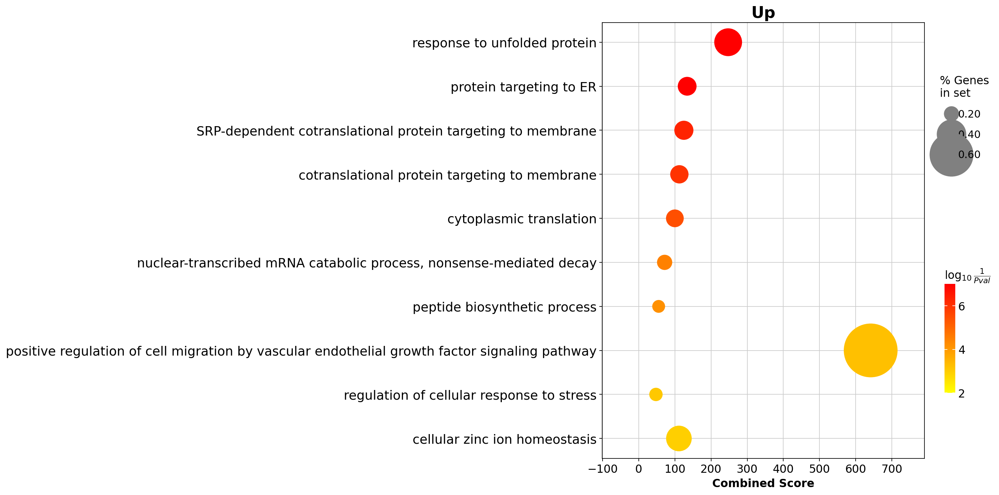

In [1347]:
# dotplot
gseapy.plot.dotplot(enr_up.res2d, figsize=(9,10), title="Up", cmap = plt.cm.autumn_r, size = 15)
plt.show()

In [1348]:
enr_dw = gseapy.enrichr(degs_dw['Parkinson disease_names'],
                    gene_sets='GO_Biological_Process_2021',
                    outdir=None)

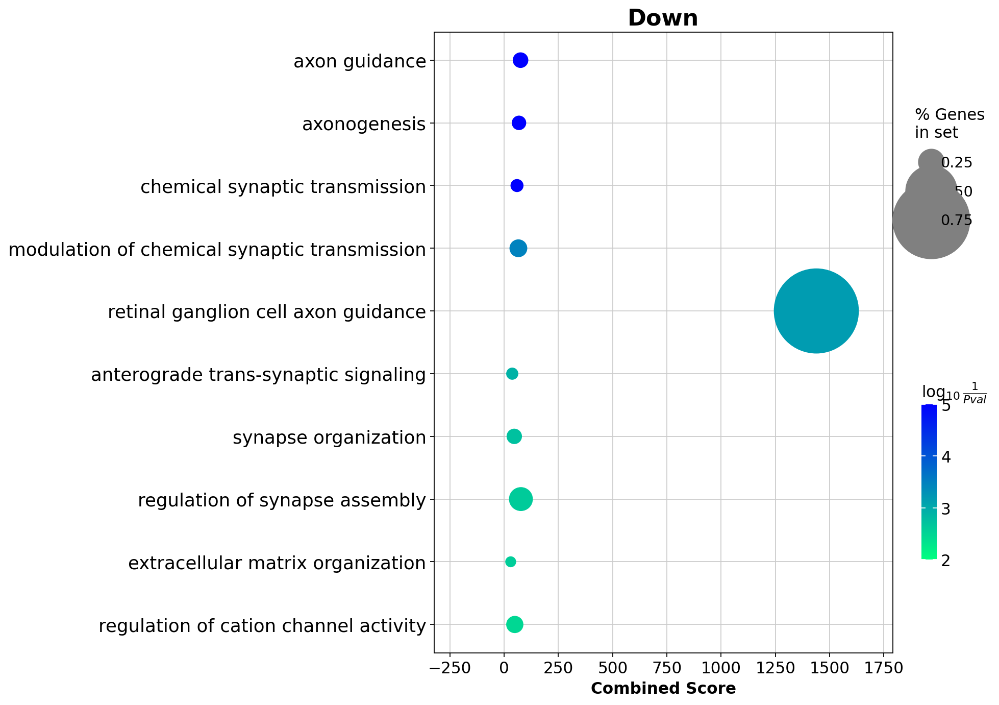

In [1349]:
enr_dw.res2d.Term = enr_dw.res2d.Term.str.split(" \(GO").str[0]
gseapy.dotplot(enr_dw.res2d,
           figsize=(9,10),
           title="Down",
           cmap = plt.cm.winter_r,
           size=15)
plt.show()

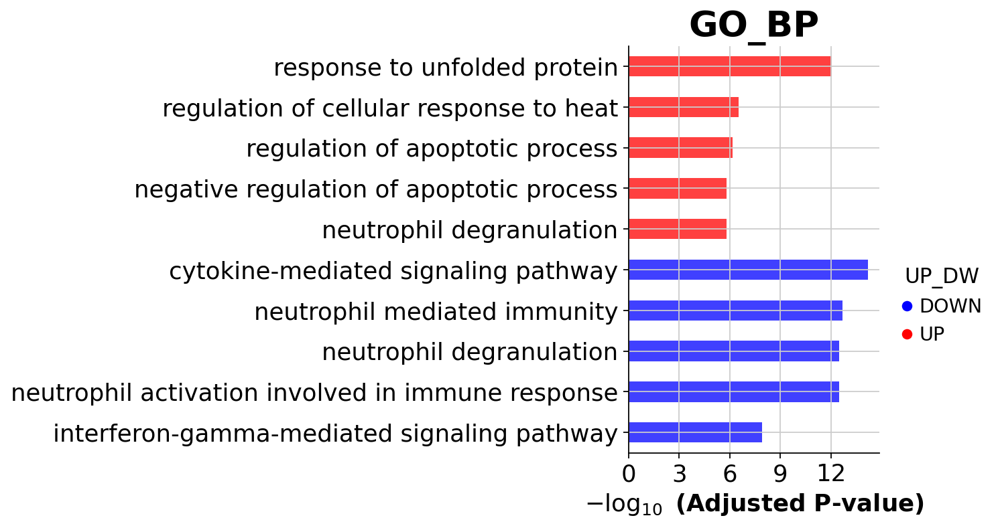

In [1350]:
ax = gseapy.barplot(enr_res, figsize=(3,5),
                group ='UP_DW',
                title ="GO_BP",
                color = ['b','r'])

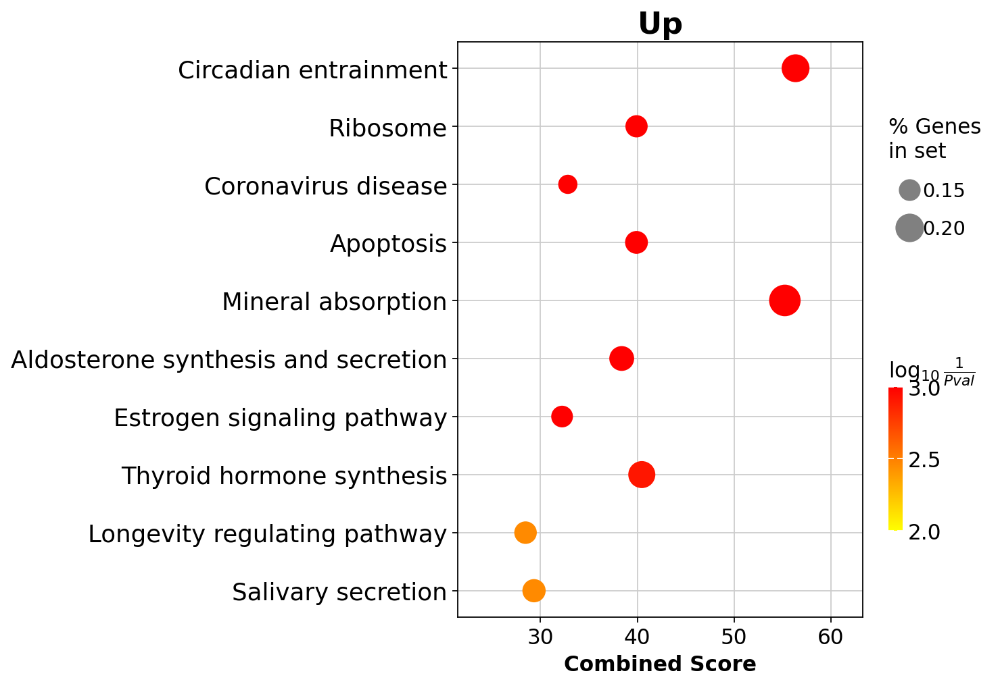

In [1351]:
# Enricr API - KEGG_2021_Human
enr_up = gseapy.enrichr(degs_up['Parkinson disease_names'],
                    gene_sets='KEGG_2021_Human',
                    outdir=None)

enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]

# dotplot
gseapy.plot.dotplot(enr_up.res2d, figsize=(6,7), title="Up", cmap = plt.cm.autumn_r, size = 15)
plt.show()

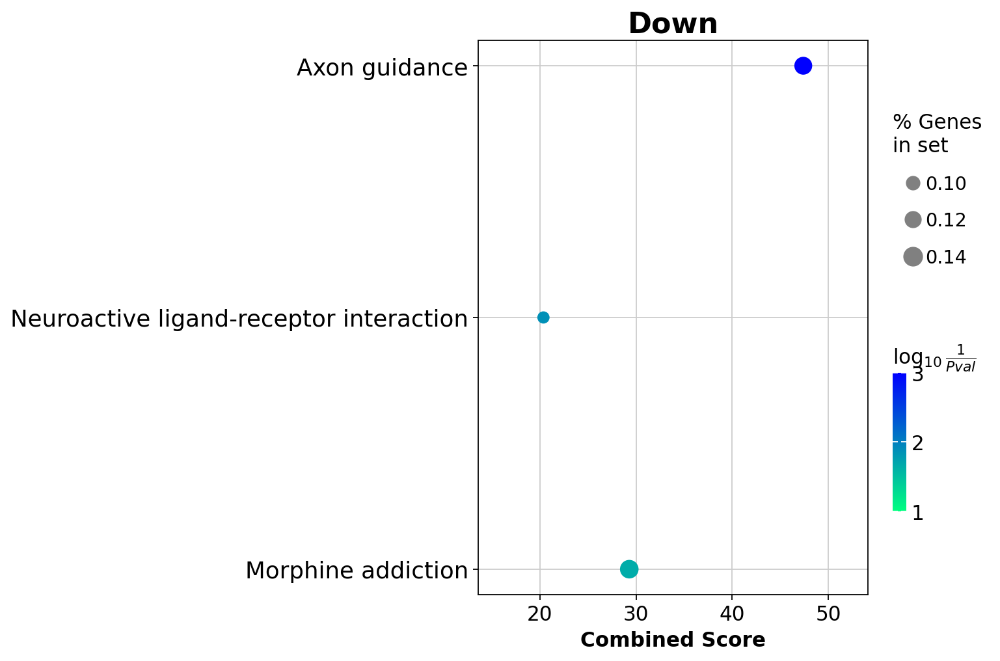

In [1352]:
enr_dw = gseapy.enrichr(degs_dw['Parkinson disease_names'],
                    gene_sets='KEGG_2021_Human',
                    outdir=None)

enr_dw.res2d.Term = enr_dw.res2d.Term.str.split(" \(GO").str[0]

gseapy.dotplot(enr_dw.res2d,
           figsize=(6,7),
           title="Down",
           cmap = plt.cm.winter_r,
           size=15)
plt.show()

### Network Visualization in Neurons

Based on the occurences in Lead_genes

In [1353]:
import networkx as nx

In [1354]:
res.res2d.head()

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,gsea,Neural Crest Differentiation WP2064,0.517002,1.773906,0.004024,0.665174,0.264,23/38,33.36%,OLIG1;OLIG2;SMAD1;FGFR3;SOX5;RHOB;NOTCH1;TCF7L...
1,gsea,Cardiac Progenitor Differentiation WP2406,0.604067,1.756582,0.00611,0.400535,0.298,8/17,20.54%,SOX2;PDGFRA;NOTCH1;BMP1;CXCR4;BMP4;THY1;FGF2
2,gsea,B Cell Receptor Signaling Pathway WP23,0.583023,1.733088,0.008421,0.3457,0.348,19/35,21.21%,BCL6;CD22;RASGRP3;FOXO1;LAT2;SYK;BLNK;INPP5D;L...
3,gsea,Oligodendrocyte specification and differentiat...,0.629804,1.726404,0.01875,0.274474,0.365,10/17,20.54%,OLIG1;OLIG2;MAG;CNP;SOX8;SOX5;GLI2;BMP4;SOX9;FGF2
4,gsea,IL-3 signaling pathway WP286,0.636691,1.709088,0.006356,0.259633,0.407,11/18,24.22%,SYK;CD86;INPP5D;LYN;BCL2;CD69;PTPN6;HCK;IL3RA;...


In [1355]:
from gseapy import enrichment_map
nodes, edges = gseapy.enrichment_map(res.res2d, column='NES')

In [1356]:
nodes.head()

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes,Hits_ratio
node_idx,,,,,,,,,,,
0,gsea,Endochondral Ossification with Skeletal Dyspla...,0.456863,1.606893,0.012552,0.32311,0.636,14/33,21.87%,CDKN1C;SPP1;ADAMTS4;SERPINH1;CALM1;FGFR3;SOX5;...,0.424242
1,gsea,Endochondral Ossification WP474,0.456863,1.606893,0.012552,0.32311,0.636,14/33,21.87%,CDKN1C;SPP1;ADAMTS4;SERPINH1;CALM1;FGFR3;SOX5;...,0.424242
2,gsea,Aryl Hydrocarbon Receptor Netpath WP2586,0.564247,1.60725,0.036017,0.40277,0.636,5/15,18.66%,HSP90AA1;PSRC1;VEGFA;EGFR;HPGDS,0.333333
3,gsea,Aryl Hydrocarbon Receptor Pathway WP2873,0.602399,1.647909,0.024793,0.336163,0.556,5/15,15.78%,PTGES3;HSP90AA1;CAP2;SLC7A5;EGFR,0.333333
4,gsea,Oxidative Damage WP3941,0.623556,1.678483,0.016064,0.299507,0.486,9/16,24.53%,CDKN1C;BCL2;TRAF2;C5AR1;C1QB;C1QC;C3AR1;C1QA;C1S,0.562500


In [1357]:
edges.head()

,src_idx,targ_idx,src_name,targ_name,jaccard_coef,overlap_coef,overlap_genes
0,0,1,Endochondral Ossification with Skeletal Dyspla...,Endochondral Ossification WP474,1.000000,1.000000,"FGFR3,BMP7,GLI3,CALM1,VEGFA,SPP1,SOX5,FGF2,SCI..."
1,0,2,Endochondral Ossification with Skeletal Dyspla...,Aryl Hydrocarbon Receptor Netpath WP2586,0.055556,0.200000,VEGFA
2,0,4,Endochondral Ossification with Skeletal Dyspla...,Oxidative Damage WP3941,0.045455,0.111111,CDKN1C
3,0,6,Endochondral Ossification with Skeletal Dyspla...,Oligodendrocyte specification and differentiat...,0.142857,0.300000,"SOX5,SOX9,FGF2"
4,0,8,Endochondral Ossification with Skeletal Dyspla...,Cardiac Progenitor Differentiation WP2406,0.047619,0.125000,FGF2


In [1358]:
# build graph
G = nx.from_pandas_edgelist(edges,
                            source='src_idx',
                            target='targ_idx',
                            edge_attr=['jaccard_coef', 'overlap_coef', 'overlap_genes'])

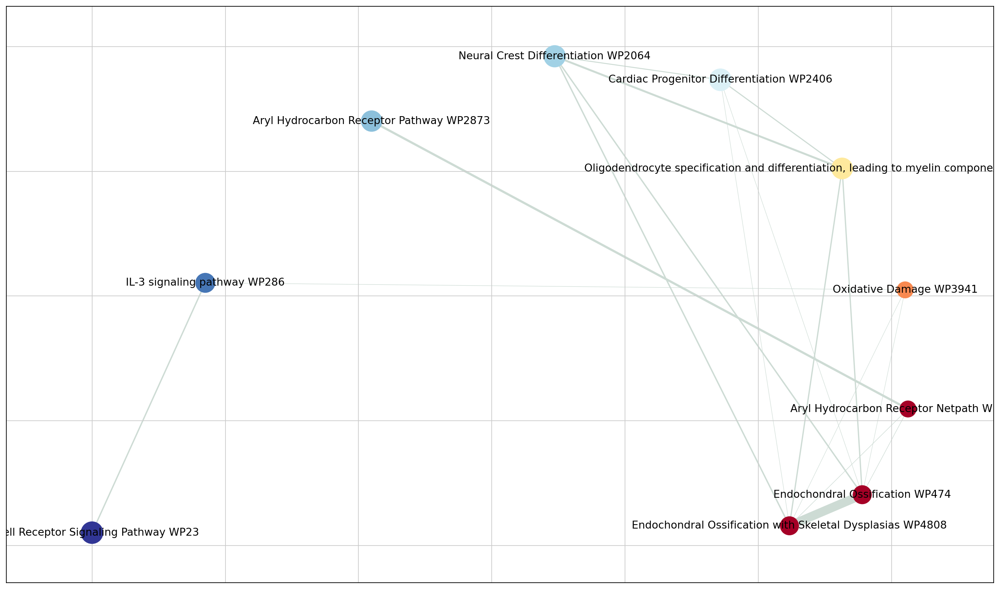

In [1359]:
fig, ax = plt.subplots(figsize=(20,12))

# init node cooridnates
pos=nx.layout.spiral_layout(G)
#node_size = nx.get_node_attributes()
# draw node
nx.draw_networkx_nodes(G,
                       pos=pos,
                       cmap=plt.cm.RdYlBu,
                       node_color=list(nodes.NES),
                       node_size=list(nodes.Hits_ratio *1000))
# draw node label
nx.draw_networkx_labels(G,
                        pos=pos,
                        labels=nodes.Term.to_dict())
# draw edge
edge_weight = nx.get_edge_attributes(G, 'jaccard_coef').values()
nx.draw_networkx_edges(G,
                       pos=pos,
                       width=list(map(lambda x: x*10, edge_weight)),
                       edge_color='#CDDBD4')
plt.show()